In [1]:
import numpy as np
from pathlib import Path
from graspy.plot import pairplot, heatmap

import sys; sys.path.append('../')
from src.tools import get_files, get_latents
from src.plotting import visualize_embeddings, make_cbar
from src.tools import align, iterate_align

import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
sns.set(color_codes=True, style='white', context='talk', font_scale=1)
PALETTE = sns.color_palette("Set1")

%load_ext autoreload
%autoreload 2

In [2]:
def load_data(source_dir, data, exclude_ids=['073'], key='latent'):
    source_dir = Path(source_dir)
    if data == 'antoine':
        flag = "_emb"
        SOURCE = 'dmap'
        ftype = 'npy'
    elif data == 'gcca':
        flag = "_gcca"
        SOURCE = 'gcca'
        ftype = 'h5'
    elif data == 'svd':
        flag = '_svd'
        SOURCE = 'gcca'
        ftype = 'h5'
    elif data == 'dmap':
        flag = '_dmap'
        SOURCE = 'gcca'
        ftype = 'h5'
    elif data == 'mase_dmap':
        flag = '_mase_dmap'
        SOURCE = 'gcca'
        ftype = 'h5'
    elif data == 'mase':
        flag = '_mase'
        SOURCE = 'gcca'
        ftype = 'h5'
    return get_latents(
        source_dir, flag=flag, ids=True, ftype=ftype, source=SOURCE, subjects_exclude=exclude_ids, as_groups=False,
        h5_key=key
    )

## Aligned dmaps (mgz)

In [22]:
source_dir = '/mnt/ssd3/ronan/data/dmap_replication_align-100_01-04'
data = 'dmap'
Xs, labels, subjs = load_data(source_dir, data)
print(np.linalg.norm(Xs[0], axis=0))

sort_idx = np.argsort(subjs)
Xs = Xs[sort_idx]
labels = labels[sort_idx]
subjs = subjs[sort_idx]
labels_st = [l[0] + ' ' + l[1] for l in labels]
labels_subj_st = [f'{subj}, {l}' for subj,l in zip(subjs, labels_st)]

[378.6222  348.1065  218.7511  167.40236 211.52151]


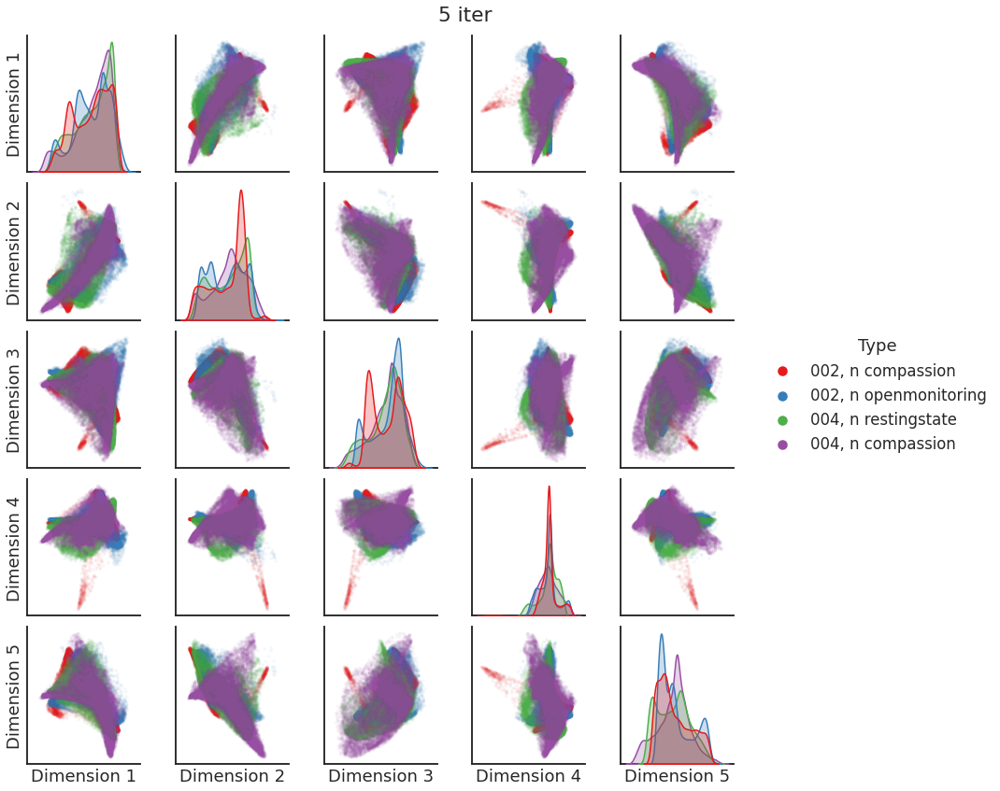

In [23]:
embeddings = Xs / np.linalg.norm(Xs, axis=1, keepdims=True)
pairplot(
    np.vstack(embeddings[1:5]),
    labels=np.hstack([[l]*18715 for l in labels_subj_st[1:5]]),
    alpha=0.05,
    title=f'5 iter'
)

<Figure size 432x288 with 0 Axes>

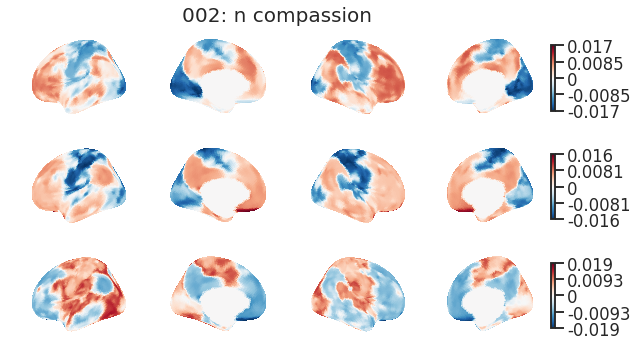

<Figure size 432x288 with 0 Axes>

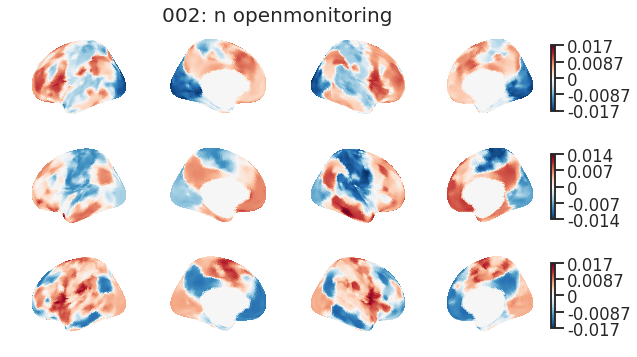

<Figure size 432x288 with 0 Axes>

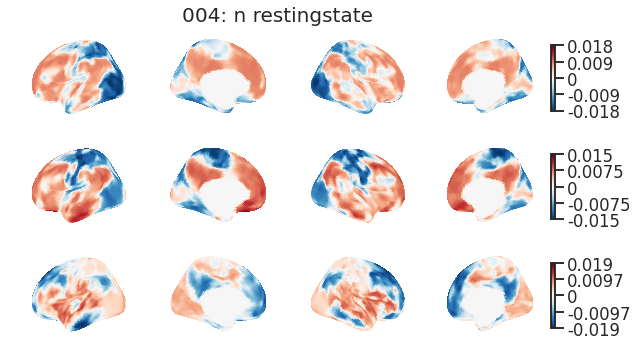

<Figure size 432x288 with 0 Axes>

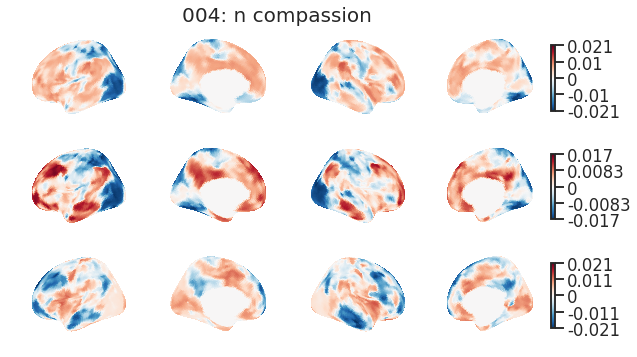

In [24]:
n_embed = 3
for X, subj, (trait, state) in zip(embeddings[1:5], subjs[1:5], labels[1:5]):
    title = f'{subj}: {trait} {state}'
    fig = visualize_embeddings(
        X[:, :n_embed],
        save_path=False,
        colorbar=True,
        n_embed=n_embed,
        # vmax=vmax,
        title=title,
    )
    plt.show()

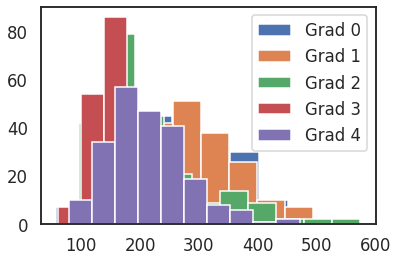

In [26]:
fig, ax = plt.subplots(1,1)
for g in range(5):
    ax.hist(np.linalg.norm(Xs, axis=1)[:, g], label=f'Grad {g}')
plt.legend()
plt.show()

## Aligned normed dmaps (mgz)

In [51]:
source_dir = '/mnt/ssd3/ronan/data/dmap_replication_align-100_normed_01-04'
data = 'dmap'
Xs, labels, subjs = load_data(source_dir, data)
print(np.linalg.norm(Xs[0], axis=0))

sort_idx = np.argsort(subjs)
Xs = Xs[sort_idx]
labels = labels[sort_idx]
subjs = subjs[sort_idx]
labels_st = [l[0] + ' ' + l[1] for l in labels]
labels_subj_st = [f'{subj}, {l}' for subj,l in zip(subjs, labels_st)]

[1.0129071  1.0040878  0.9873901  0.99610144 0.9993264 ]


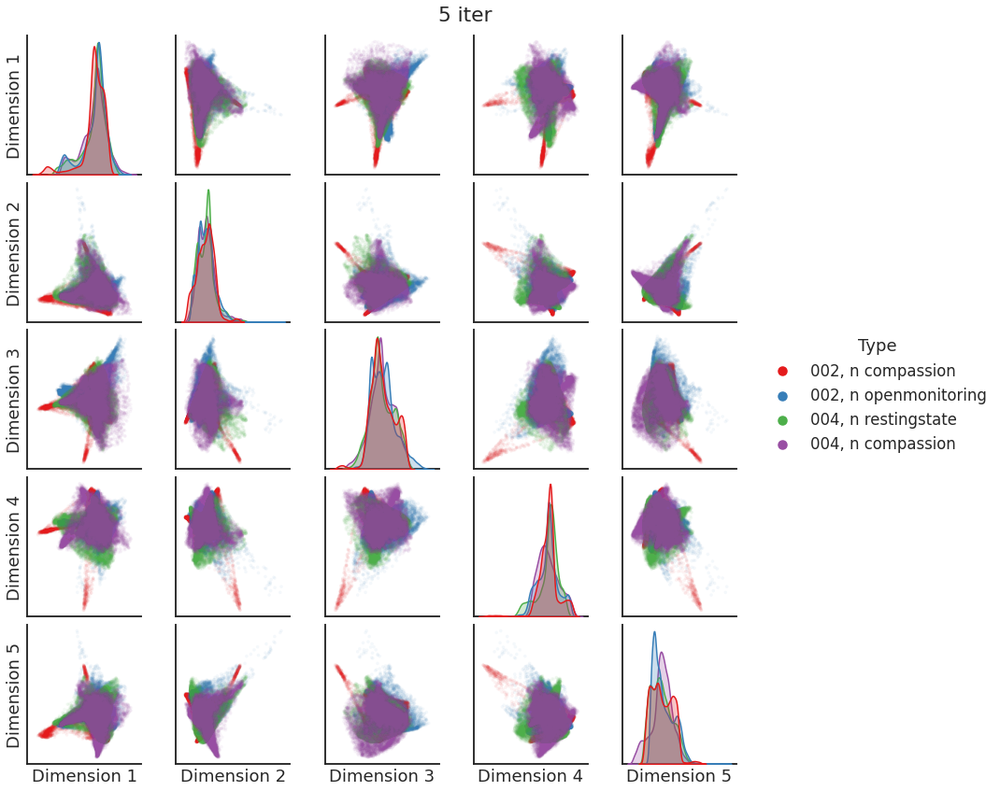

In [52]:
embeddings = Xs / np.linalg.norm(Xs, axis=1, keepdims=True)
pairplot(
    np.vstack(embeddings[1:5]),
    labels=np.hstack([[l]*18715 for l in labels_subj_st[1:5]]),
    alpha=0.05,
    title=f'5 iter'
)

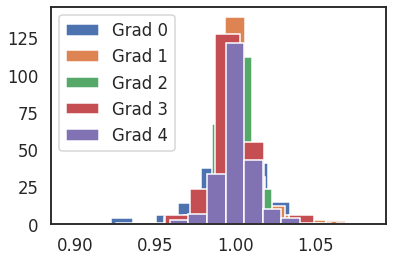

In [53]:
fig, ax = plt.subplots(1,1)
for g in range(5):
    ax.hist(np.linalg.norm(Xs, axis=1)[:, g], label=f'Grad {g}')
plt.legend()
plt.show()

<Figure size 432x288 with 0 Axes>

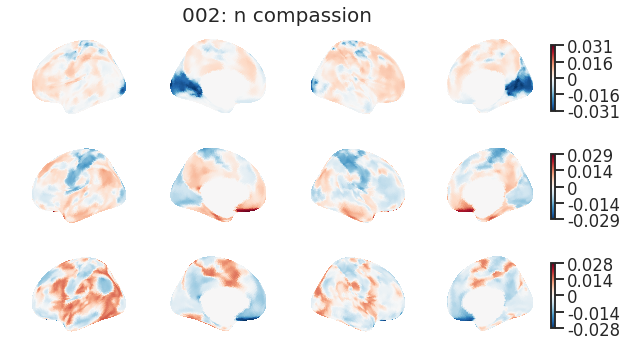

<Figure size 432x288 with 0 Axes>

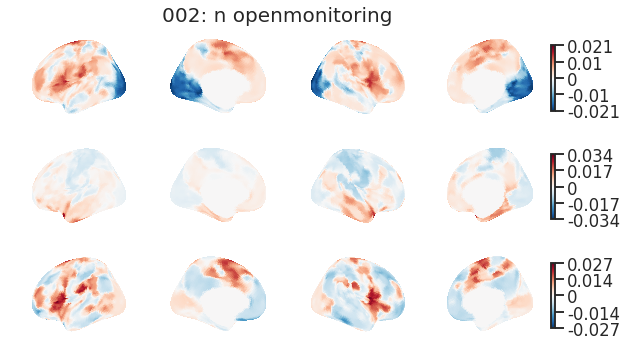

<Figure size 432x288 with 0 Axes>

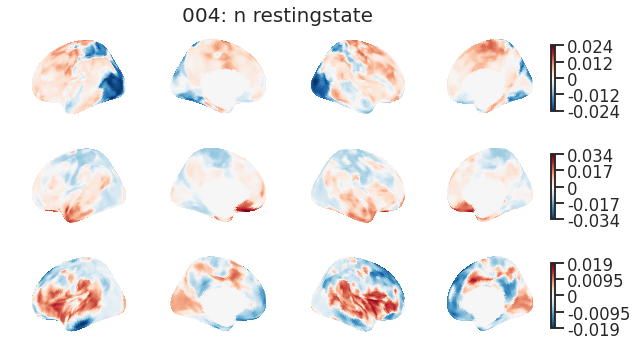

<Figure size 432x288 with 0 Axes>

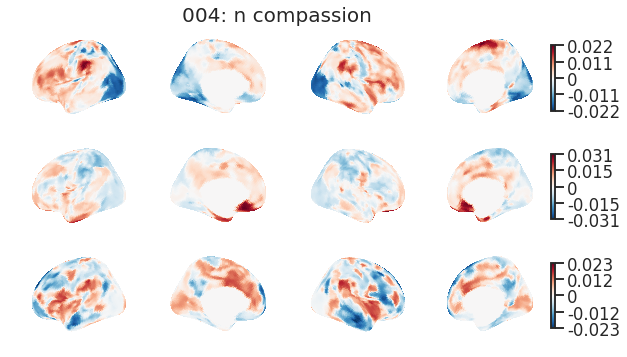

In [54]:
n_embed = 3
for X, subj, (trait, state) in zip(embeddings[1:5], subjs[1:5], labels[1:5]):
    title = f'{subj}: {trait} {state}'
    fig = visualize_embeddings(
        X[:, :n_embed],
        save_path=False,
        colorbar=True,
        n_embed=n_embed,
        # vmax=vmax,
        title=title,
    )
    plt.show()

## Aligned dmaps (from csv)

In [27]:
source_dir = '/mnt/ssd3/ronan/data/dmap_replication-csv_align-100_12-04'
data = 'dmap'
Xs, labels, subjs = load_data(source_dir, data)
print(np.linalg.norm(Xs[0], axis=0))

sort_idx = np.argsort(subjs)
Xs = Xs[sort_idx]
labels = labels[sort_idx]
subjs = subjs[sort_idx]
labels_st = [l[0] + ' ' + l[1] for l in labels]
labels_subj_st = [f'{subj}, {l}' for subj,l in zip(subjs, labels_st)]

[501.84942237 160.09304218 175.69181254 195.26974996 196.6873989 ]


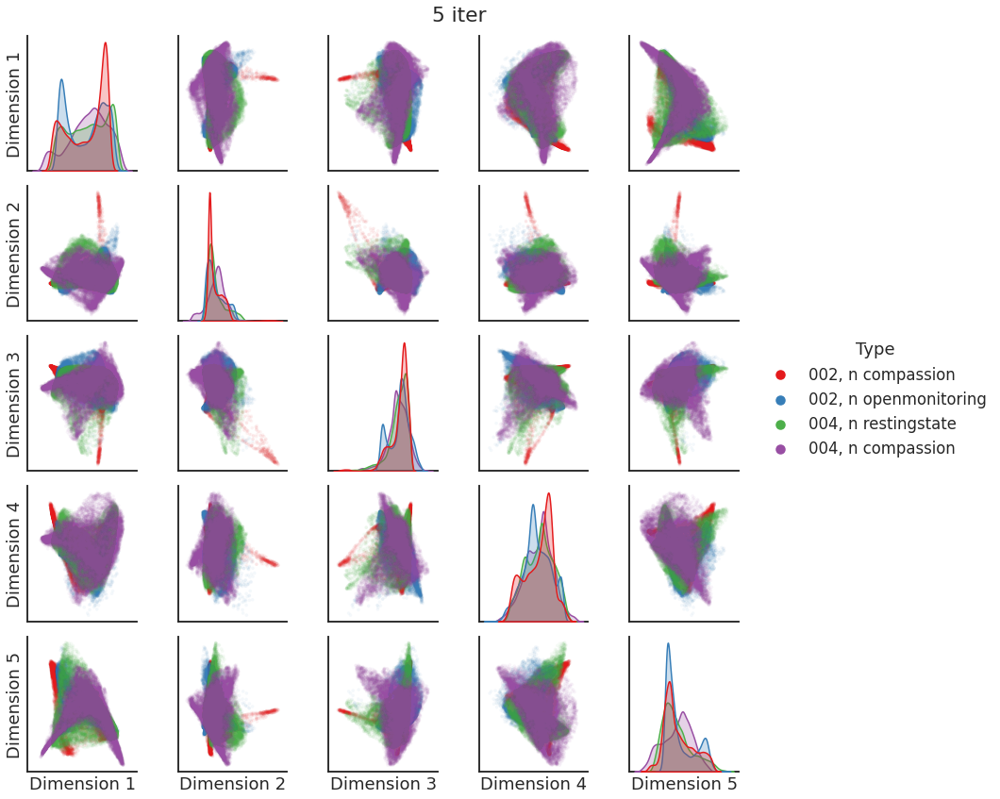

In [19]:
embeddings = Xs / np.linalg.norm(Xs, axis=1, keepdims=True)
pairplot(
    np.vstack(embeddings[1:5]),
    labels=np.hstack([[l]*18715 for l in labels_subj_st[1:5]]),
    alpha=0.05,
    title=f'5 iter'
)

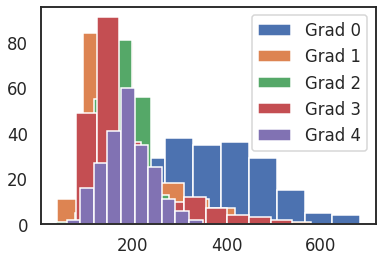

In [13]:
fig, ax = plt.subplots(1,1)
for g in range(5):
    ax.hist(np.linalg.norm(Xs, axis=1)[:, g], label=f'Grad {g}')
plt.legend()
plt.show()

<Figure size 432x288 with 0 Axes>

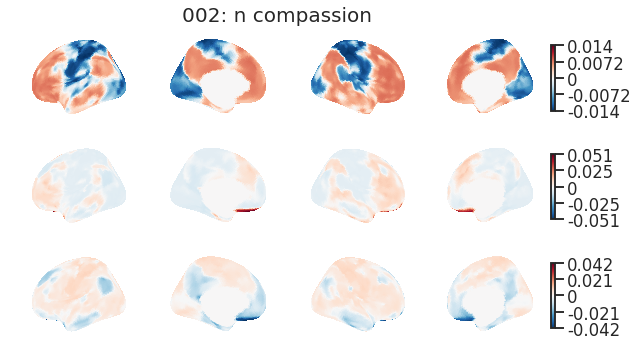

<Figure size 432x288 with 0 Axes>

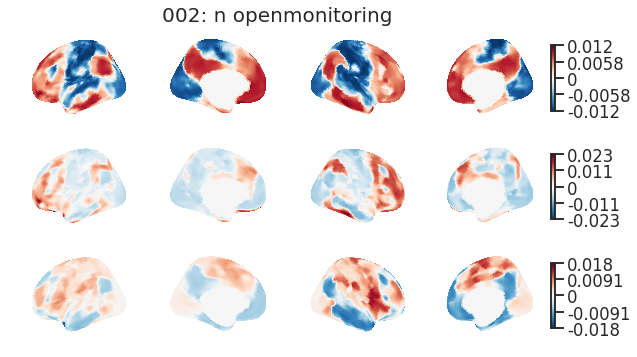

<Figure size 432x288 with 0 Axes>

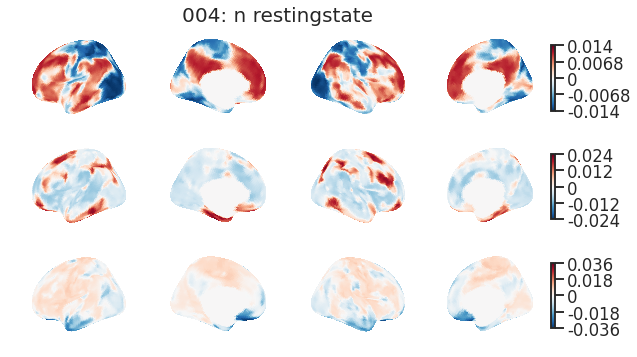

<Figure size 432x288 with 0 Axes>

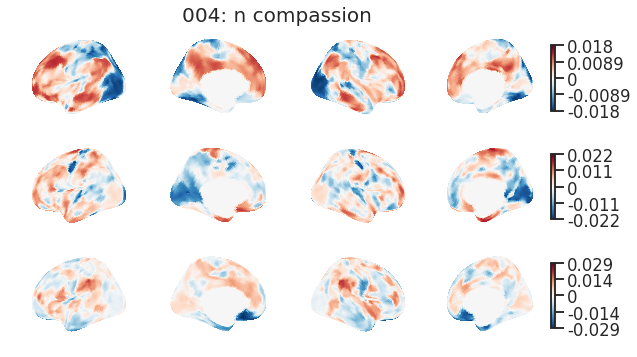

In [29]:
n_embed = 3
for X, subj, (trait, state) in zip(embeddings[1:5], subjs[1:5], labels[1:5]):
    title = f'{subj}: {trait} {state}'
    fig = visualize_embeddings(
        X[:, :n_embed],
        save_path=False,
        colorbar=True,
        n_embed=n_embed,
        # vmax=vmax,
        title=title,
    )
    plt.show()

In [9]:
source_dir = '/mnt/ssd3/ronan/data/dmap_replication-csv_aligned_12-04'
data = 'dmap'
Xs, labels, subjs = load_data(source_dir, data)
print(np.linalg.norm(Xs[0], axis=0))

sort_idx = np.argsort(subjs)
Xs = Xs[sort_idx]
labels = labels[sort_idx]
subjs = subjs[sort_idx]
labels_st = [l[0] + ' ' + l[1] for l in labels]
labels_subj_st = [f'{subj}, {l}' for subj,l in zip(subjs, labels_st)]

[1.00013217 0.99989237 1.00104866 0.99883271 1.00009284]


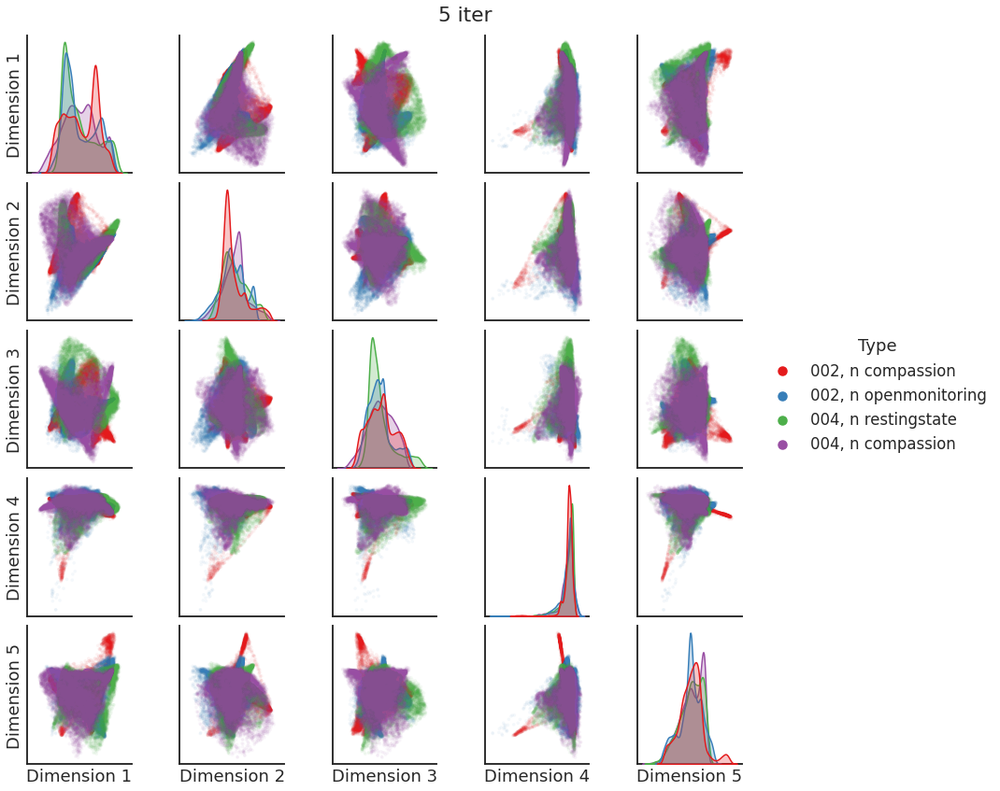

In [12]:
embeddings2 = Xs
pairplot(
    np.vstack(embeddings2[1:5]),
    labels=np.hstack([[l]*18715 for l in labels_subj_st[1:5]]),
    alpha=0.05,
    title=f'5 iter'
)

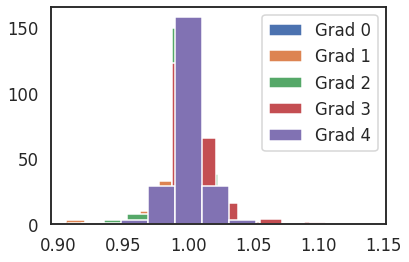

In [16]:
fig, ax = plt.subplots(1,1)
for g in range(5):
    ax.hist(np.linalg.norm(embeddings2, axis=1)[:, g], label=f'Grad {g}')
plt.legend()
plt.show()

<Figure size 432x288 with 0 Axes>

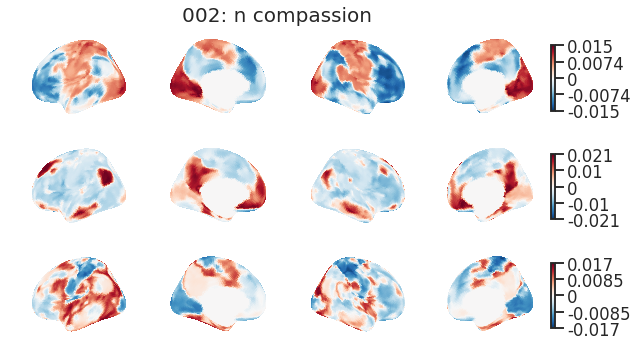

<Figure size 432x288 with 0 Axes>

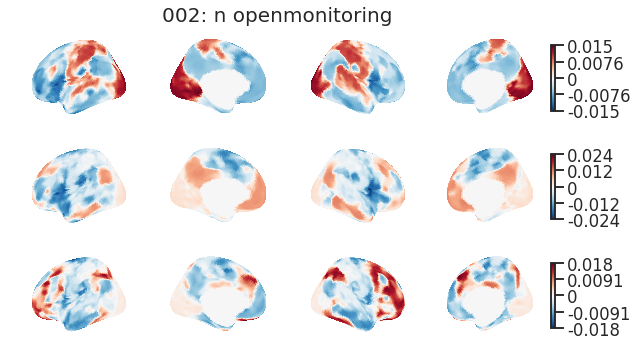

<Figure size 432x288 with 0 Axes>

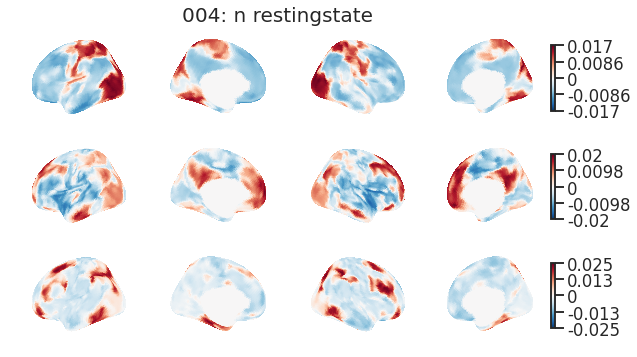

<Figure size 432x288 with 0 Axes>

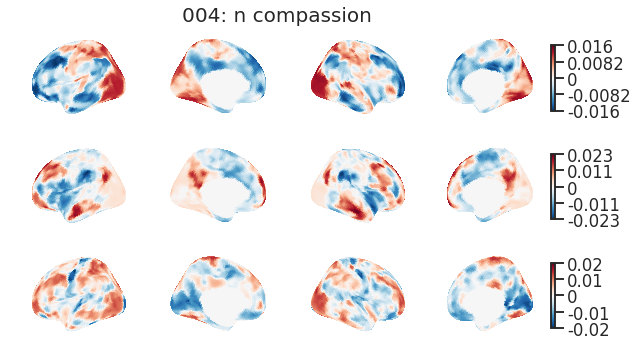

In [17]:
n_embed = 3
for X, subj, (trait, state) in zip(embeddings2[1:5], subjs[1:5], labels[1:5]):
    title = f'{subj}: {trait} {state}'
    fig = visualize_embeddings(
        X[:, :n_embed],
        save_path=False,
        colorbar=True,
        n_embed=n_embed,
        # vmax=vmax,
        title=title,
    )
    plt.show()

## Replicated dmap embeddings (mgc)

In [14]:
source_dir = '/mnt/ssd3/ronan/data/dmap_replication_01-04'
data = 'dmap'
Xs, labels, subjs = load_data(source_dir, data)
print(np.linalg.norm(Xs[0], axis=0))

sort_idx = np.argsort(subjs)
Xs = Xs[sort_idx]
labels = labels[sort_idx]
subjs = subjs[sort_idx]
labels_st = [l[0] + ' ' + l[1] for l in labels]
labels_subj_st = [f'{subj}, {l}' for subj,l in zip(subjs, labels_st)]

[507.79474  266.25708  174.2039   125.606476 101.38447 ]


<Figure size 432x288 with 0 Axes>

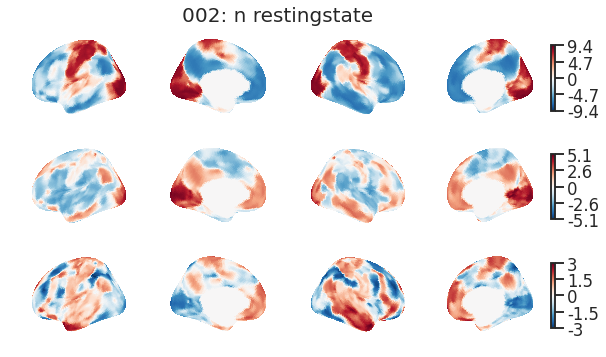

In [16]:
n_embed = 3
for X, subj, (trait, state) in zip(Xs, subjs, labels):
    title = f'{subj}: {trait} {state}'
    fig = visualize_embeddings(
        X[:, :n_embed],
        save_path=False,
        colorbar=True,
        n_embed=n_embed,
        # vmax=vmax,
        title=title,
    )
    plt.show()
    break

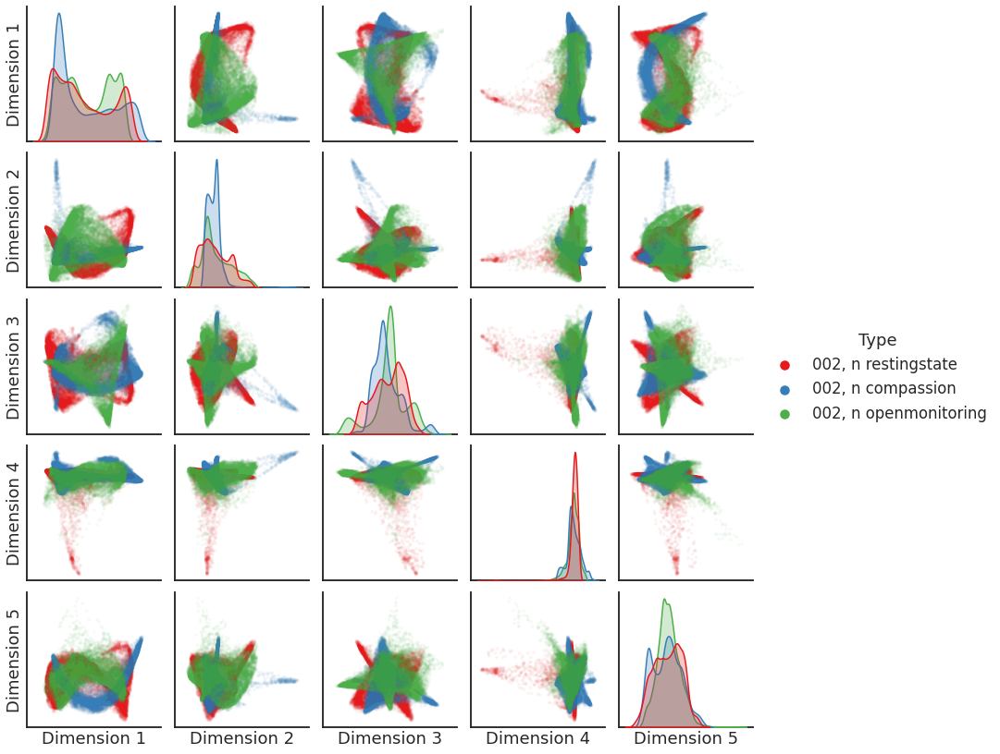

In [15]:
pairplot(np.vstack(Xs[:3]), labels=np.hstack([[l]*18715 for l in labels_subj_st[:3]]), alpha=0.05)

In [17]:
n_iter = 5
embeddings, _, _ = iterate_align(
    Xs / np.linalg.norm(Xs, axis=1, keepdims=True), labels, subjs, thresh=0.0001, max_iter=n_iter, norm=False, mean_align=False, debug=False)

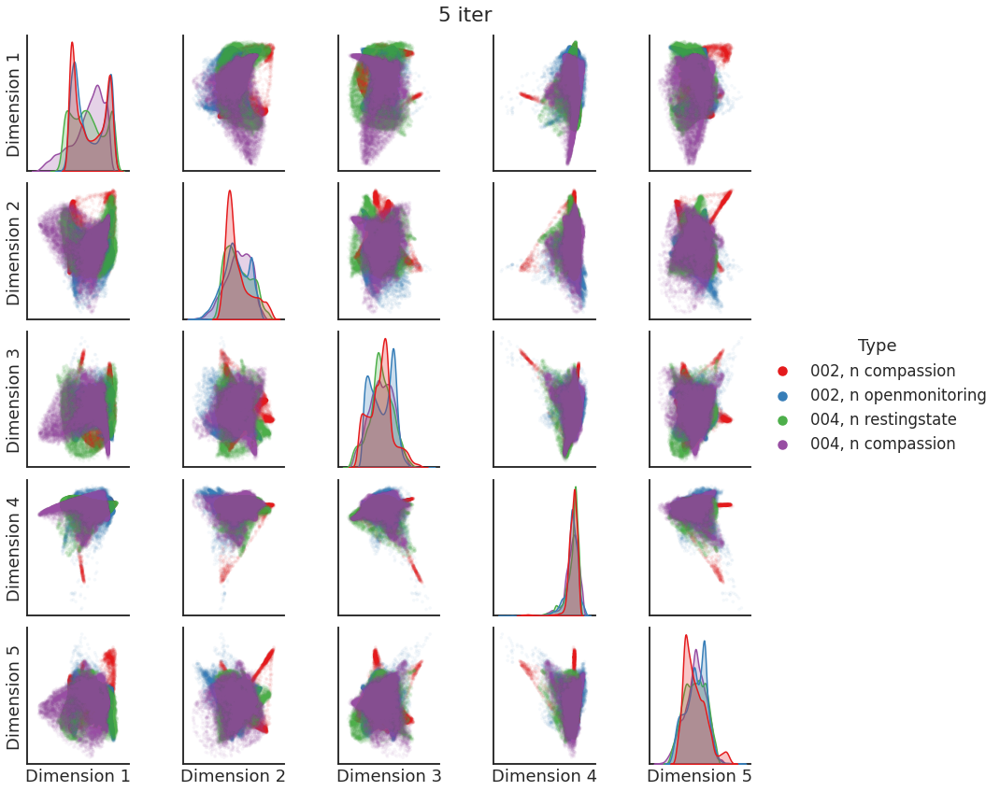

In [18]:
pairplot(
    np.vstack(embeddings[1:5]),
    labels=np.hstack([[l]*18715 for l in labels_subj_st[1:5]]),
    alpha=0.05,
    title=f'5 iter'
)

## Replicated dmap embeddings

In [19]:
source_dir = '/mnt/ssd3/ronan/data/dmap_replication-csv_12-04'
data = 'dmap'
Xs, labels, subjs = load_data(source_dir, data)
print(np.linalg.norm(Xs[0], axis=0))

sort_idx = np.argsort(subjs)
Xs = Xs[sort_idx]
labels = labels[sort_idx]
subjs = subjs[sort_idx]
labels_st = [l[0] + ' ' + l[1] for l in labels]
labels_subj_st = [f'{subj}, {l}' for subj,l in zip(subjs, labels_st)]

[507.79676009 266.25855126 174.20526674 125.60665853 101.44344588]


<Figure size 432x288 with 0 Axes>

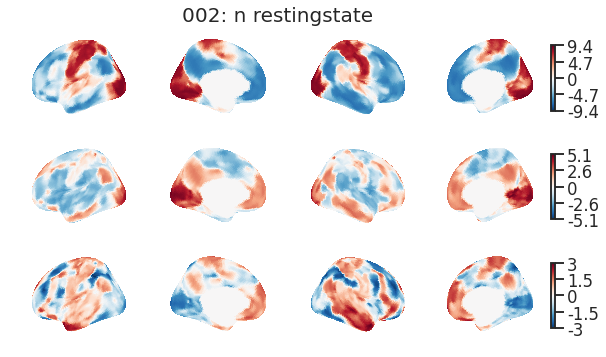

In [20]:
n_embed = 3
for X, subj, (trait, state) in zip(Xs, subjs, labels):
    title = f'{subj}: {trait} {state}'
    fig = visualize_embeddings(
        X[:, :n_embed],
        save_path=False,
        colorbar=True,
        n_embed=n_embed,
        # vmax=vmax,
        title=title,
    )
    plt.show()
    break

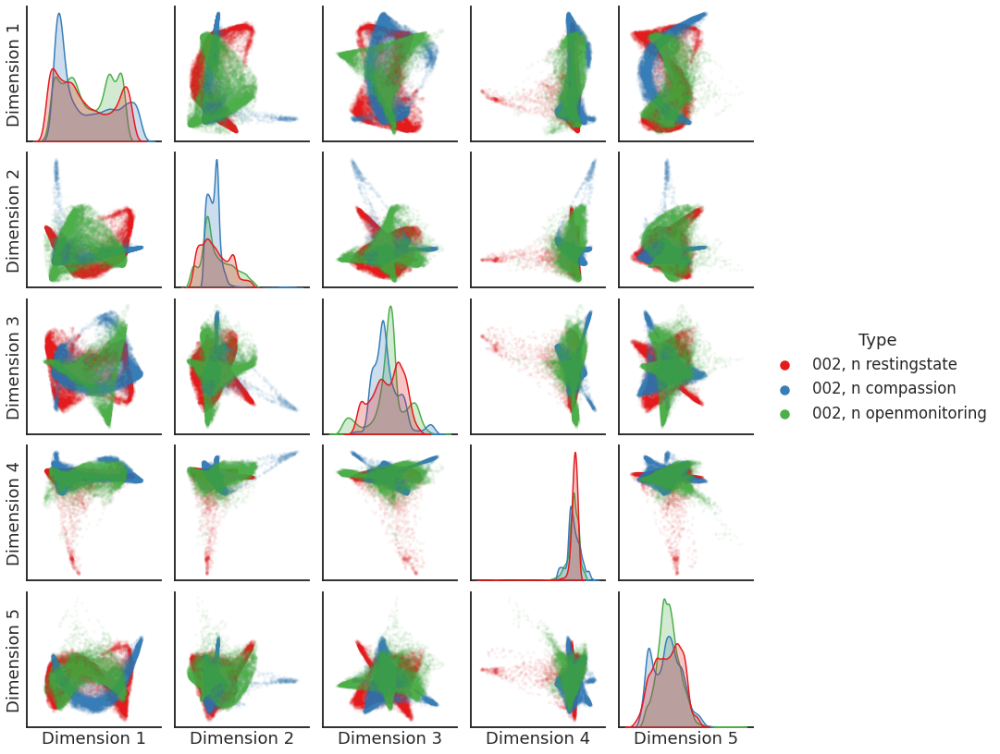

In [45]:
pairplot(np.vstack(Xs[:3]), labels=np.hstack([[l]*18715 for l in labels_subj_st[:3]]), alpha=0.05)

In [18]:
n_iter = 5
embeddings, _, _ = iterate_align(
    Xs / np.linalg.norm(Xs, axis=1, keepdims=True), labels, subjs, thresh=0.0001, max_iter=n_iter, norm=False, mean_align=False, debug=False)

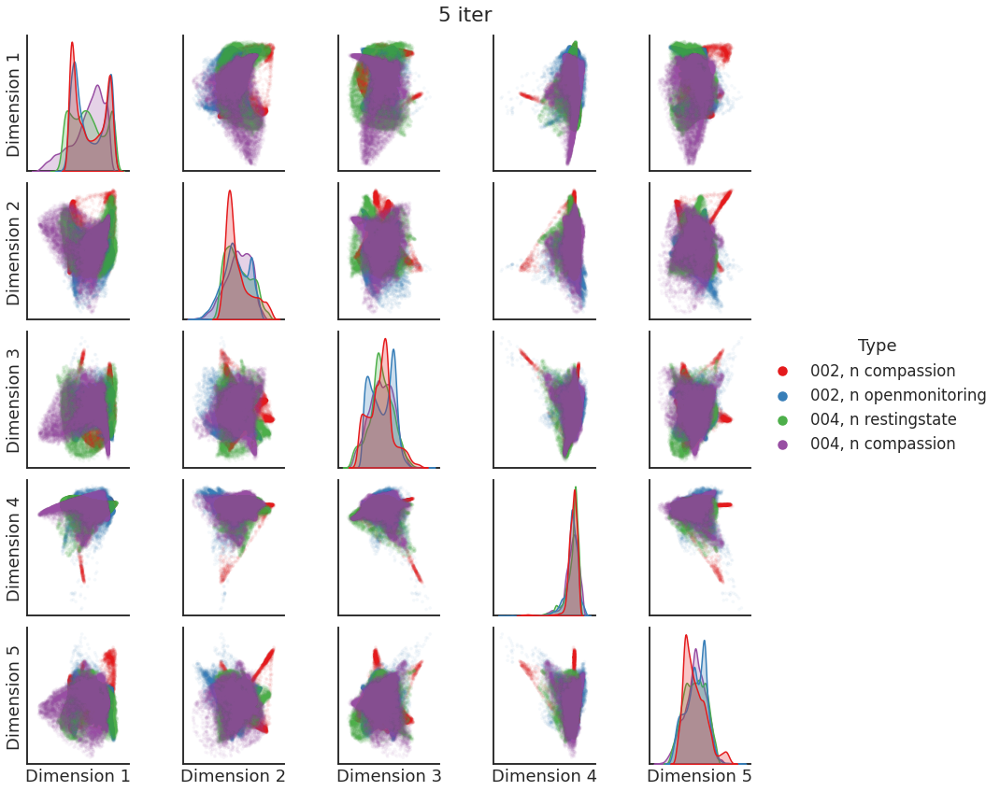

In [19]:
pairplot(
    np.vstack(embeddings[1:5]),
    labels=np.hstack([[l]*18715 for l in labels_subj_st[1:5]]),
    alpha=0.05,
    title=f'5 iter'
)

In [21]:
n_iter = 50
embeddings, _, _ = iterate_align(
    Xs / np.linalg.norm(Xs, axis=1, keepdims=True), labels, subjs, thresh=0, max_iter=n_iter, norm=False, mean_align=False, debug=False)

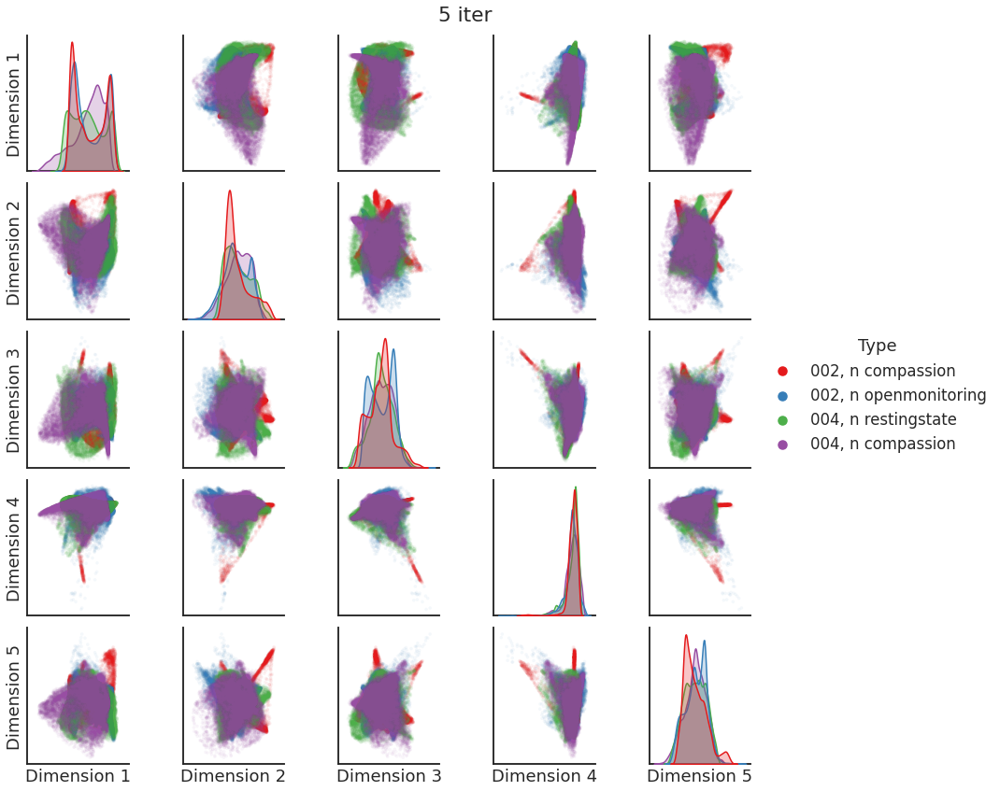

In [22]:
pairplot(
    np.vstack(embeddings[1:5]),
    labels=np.hstack([[l]*18715 for l in labels_subj_st[1:5]]),
    alpha=0.05,
    title=f'5 iter'
)

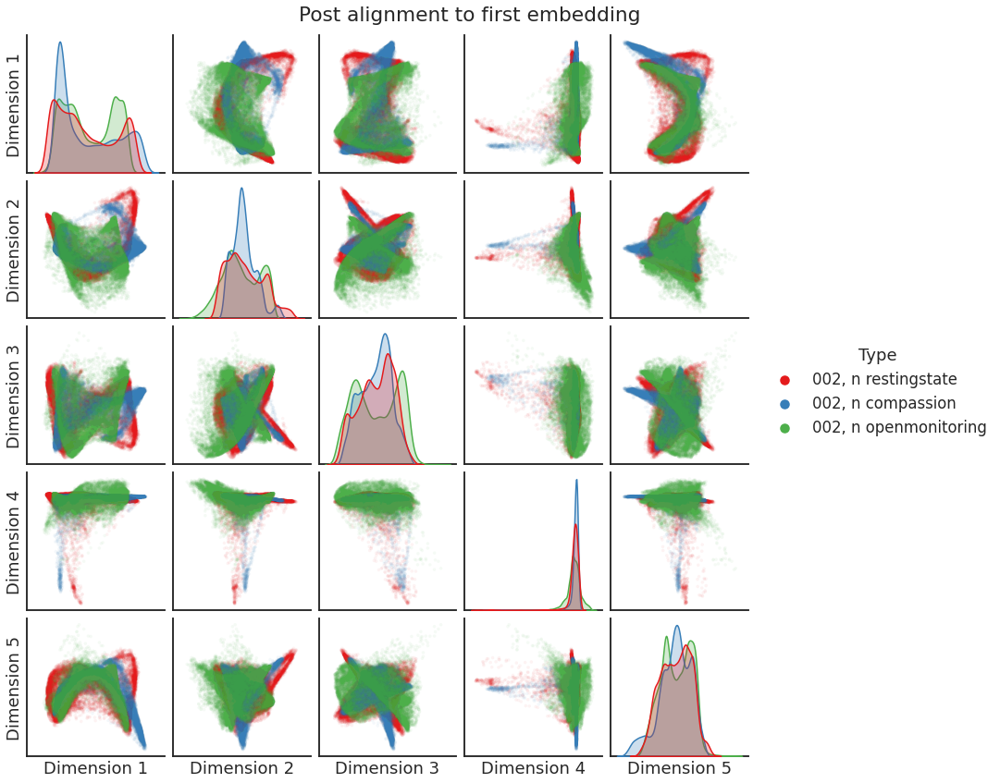

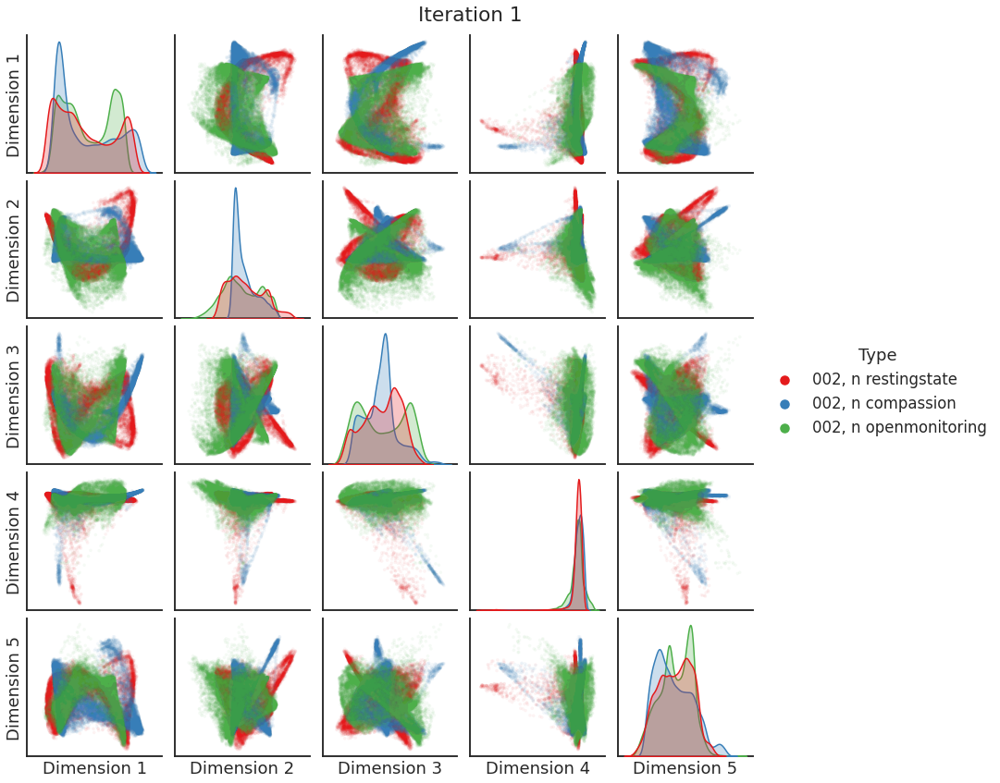

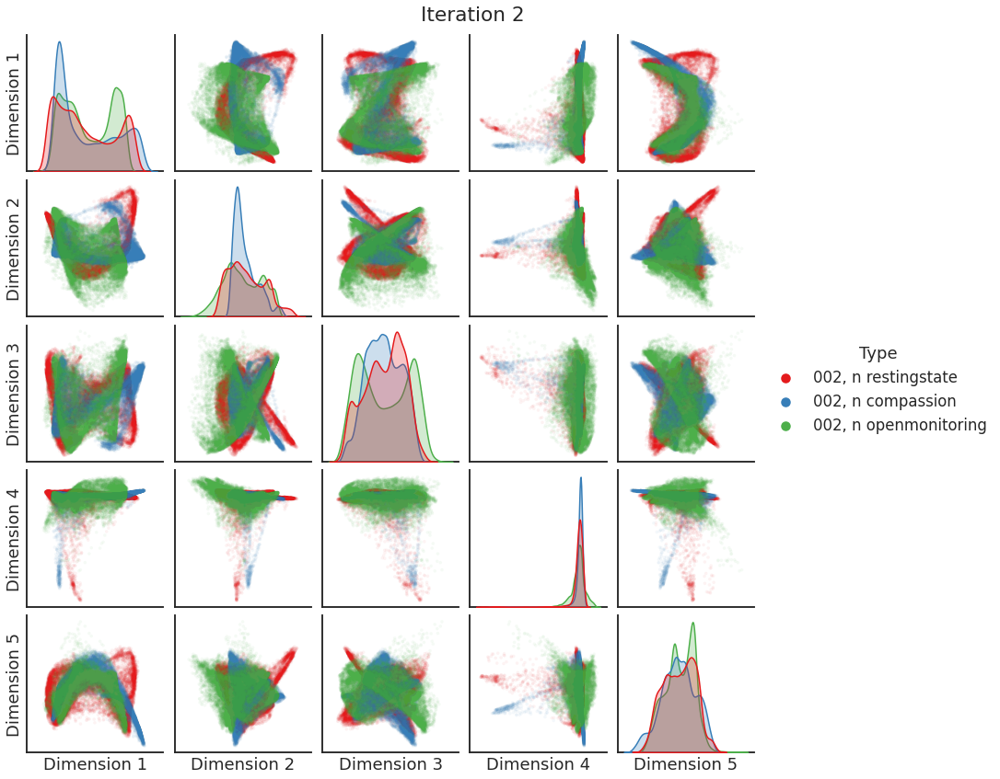

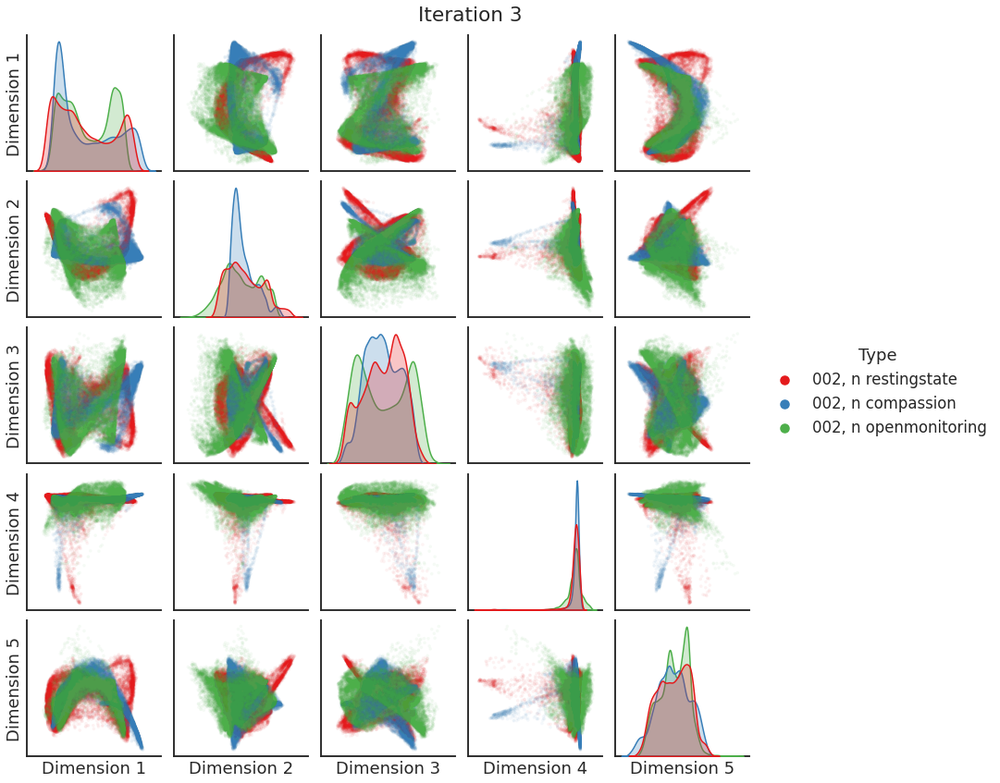

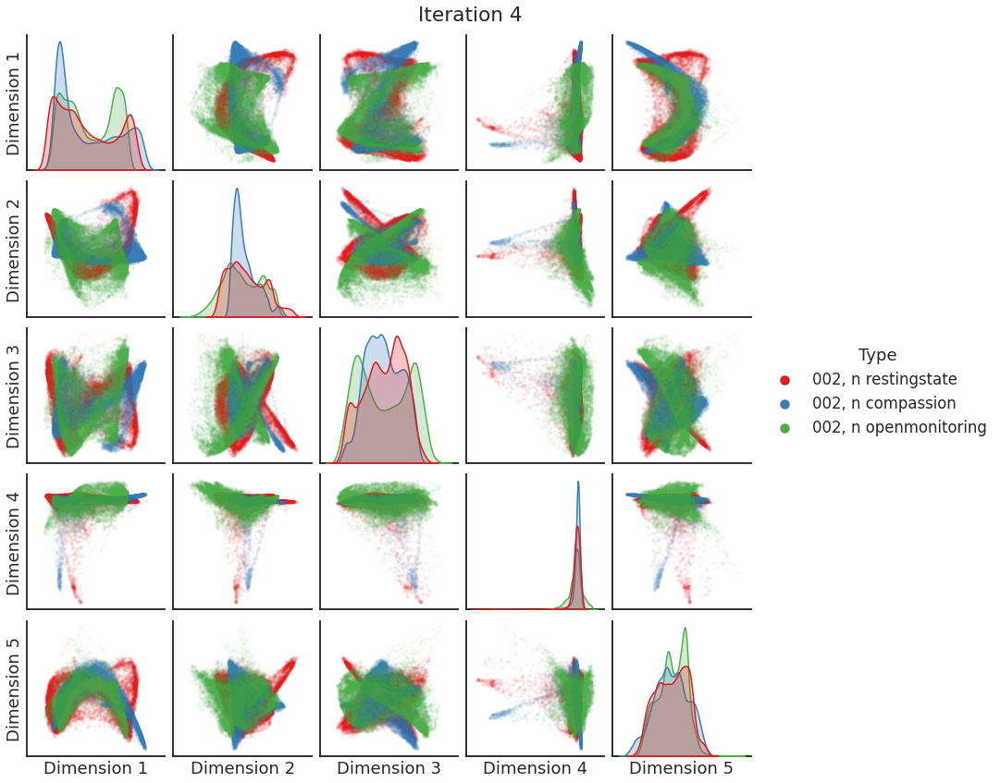

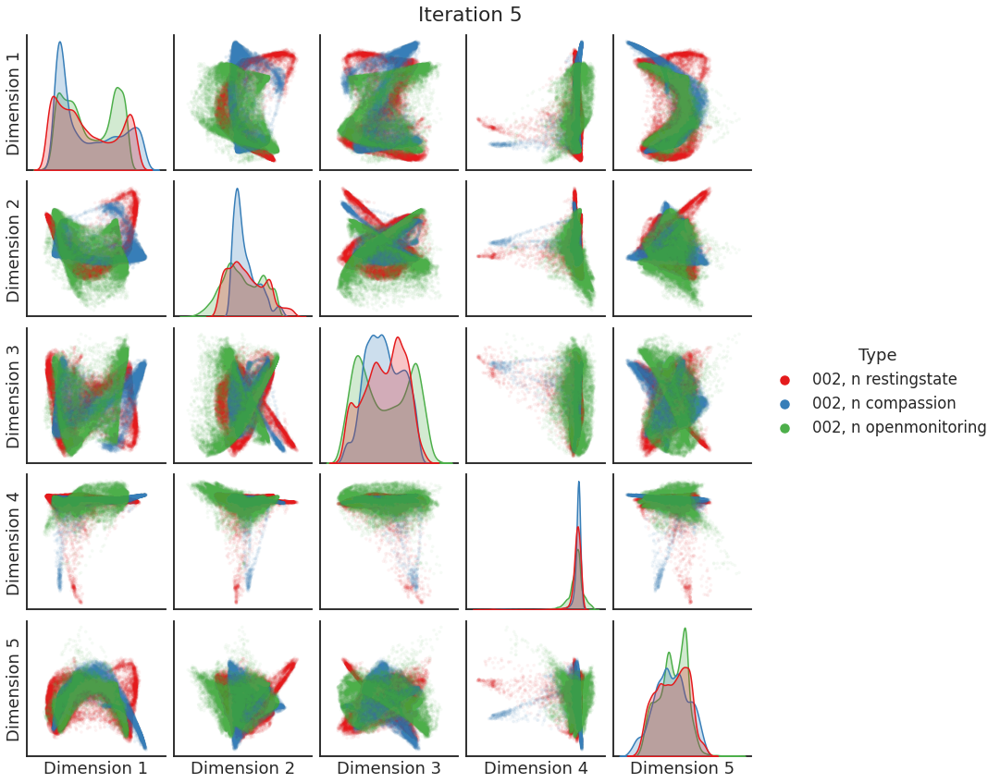

In [46]:
embeddings = Xs
max_iter = 5

embeddings = align(embeddings[1:], embeddings[0], firstpass=True)
pairplot(
    np.vstack(embeddings[:3]),
    labels=np.hstack([[l]*18715 for l in labels_subj_st[:3]]),
    alpha=0.05,
    title='Post alignment to first embedding'
)
for i in range(max_iter):
    mean = np.mean(embeddings, axis=0).squeeze()
    embeddings = align(
        embeddings, np.asarray(mean),
        firstpass=False, debug=True)
    pairplot(
        np.vstack(embeddings[:3]),
        labels=np.hstack([[l]*18715 for l in labels_subj_st[:3]]),
        alpha=0.05,
        title=f'Iteration {i+1}'
    )

/home/rflperry/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:4: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  after removing the cwd from sys.path.
/home/rflperry/miniconda3/lib/python3.7/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


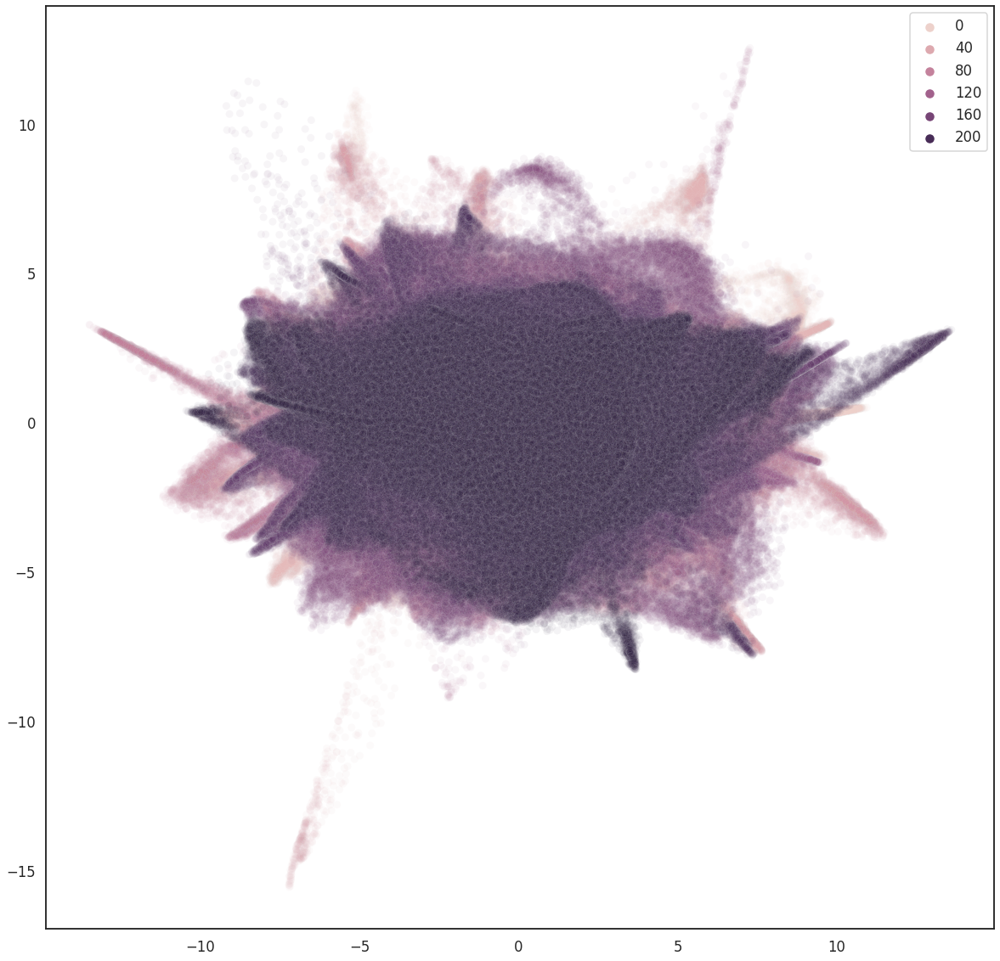

In [44]:
fig, ax = plt.subplots(figsize=(20, 20))
sns.scatterplot(
    np.hstack(Xs[:,:,0]), np.hstack(Xs[:,:,1]),
    hue=np.hstack([[l]*18715 for l in labels_subj_st]),
    alpha=0.05,
    ax=ax,
)
ax.set_xlabel('Gradient 1')
ax.set_xlabel('Gradient 2')
ax.set_title('Post alignment to first embedding')

/home/rflperry/miniconda3/lib/python3.7/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning
/home/rflperry/miniconda3/lib/python3.7/site-packages/IPython/core/pylabtools.py:132: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)
/home/rflperry/miniconda3/lib/python3.7/site-packages/IPython/core/pylabtools.py:132: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)
/home/rflperry/miniconda3/lib/python3.7/site-packages/IPython/core/pylabtools.py:132: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)
/home/rflperry/miniconda3

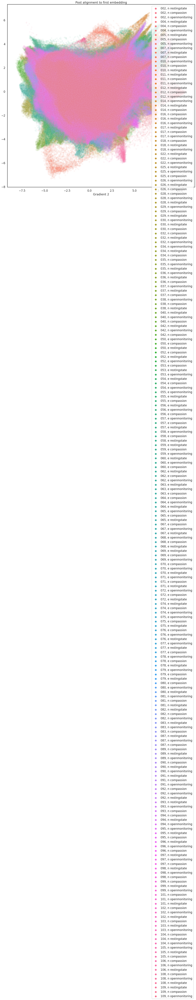

/home/rflperry/miniconda3/lib/python3.7/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning
/home/rflperry/miniconda3/lib/python3.7/site-packages/IPython/core/pylabtools.py:132: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)
/home/rflperry/miniconda3/lib/python3.7/site-packages/IPython/core/pylabtools.py:132: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)
/home/rflperry/miniconda3/lib/python3.7/site-packages/IPython/core/pylabtools.py:132: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)
/home/rflperry/miniconda3

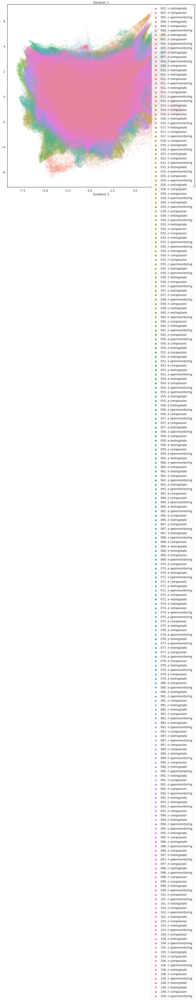

/home/rflperry/miniconda3/lib/python3.7/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning
/home/rflperry/miniconda3/lib/python3.7/site-packages/IPython/core/pylabtools.py:132: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)
/home/rflperry/miniconda3/lib/python3.7/site-packages/IPython/core/pylabtools.py:132: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)
/home/rflperry/miniconda3/lib/python3.7/site-packages/IPython/core/pylabtools.py:132: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)
/home/rflperry/miniconda3

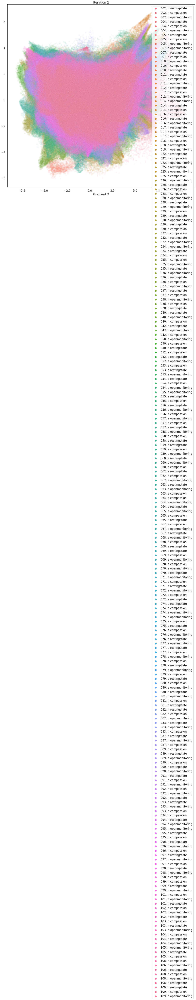

In [49]:
embeddings = Xs
max_iter = 2

embeddings = align(embeddings[1:], embeddings[0], firstpass=True)
embeddings=np.asarray(embeddings)
fig, ax = plt.subplots(figsize=(20, 20))
sns.scatterplot(
    np.hstack(embeddings[:,:,0]), np.hstack(embeddings[:,:,1]),
    hue=np.hstack([[l]*18715 for l in labels_subj_st]),
    alpha=0.05,
    ax=ax,
)
ax.set_xlabel('Gradient 1')
ax.set_xlabel('Gradient 2')
ax.set_title('Post alignment to first embedding')
plt.show()
for i in range(max_iter):
    mean = np.mean(embeddings, axis=0).squeeze()
    embeddings = align(
        embeddings, np.asarray(mean),
        firstpass=False, debug=True)
    embeddings=np.asarray(embeddings)
    fig, ax = plt.subplots(figsize=(20, 20))
    sns.scatterplot(
        np.hstack(embeddings[:,:,0]), np.hstack(embeddings[:,:,1]),
        hue=np.hstack([[l]*18715 for l in labels_subj_st]),
        alpha=0.05,
        ax=ax,
    )
    ax.set_xlabel('Gradient 1')
    ax.set_xlabel('Gradient 2')
    ax.set_title(f'Iteration {i+1}')
    plt.show()

# Antoine dmap data

In [3]:
source_dir = '/mnt/ssd3/ronan/data/dmap_antoinne_09-04'
data = 'antoine'
Xs, labels, subjs = load_data(source_dir, data)
print(np.linalg.norm(Xs[1], axis=0))

sort_idx = np.argsort(subjs)[::-1]
Xs = Xs[sort_idx]
labels = labels[sort_idx]
subjs = subjs[sort_idx]
labels_st = [l[0] + ' ' + l[1] for l in labels]
labels_subj_st = [f'{subj}, {l}' for subj,l in zip(subjs, labels_st)]

[252.59346  246.74161  168.04521  123.80227   92.611305]


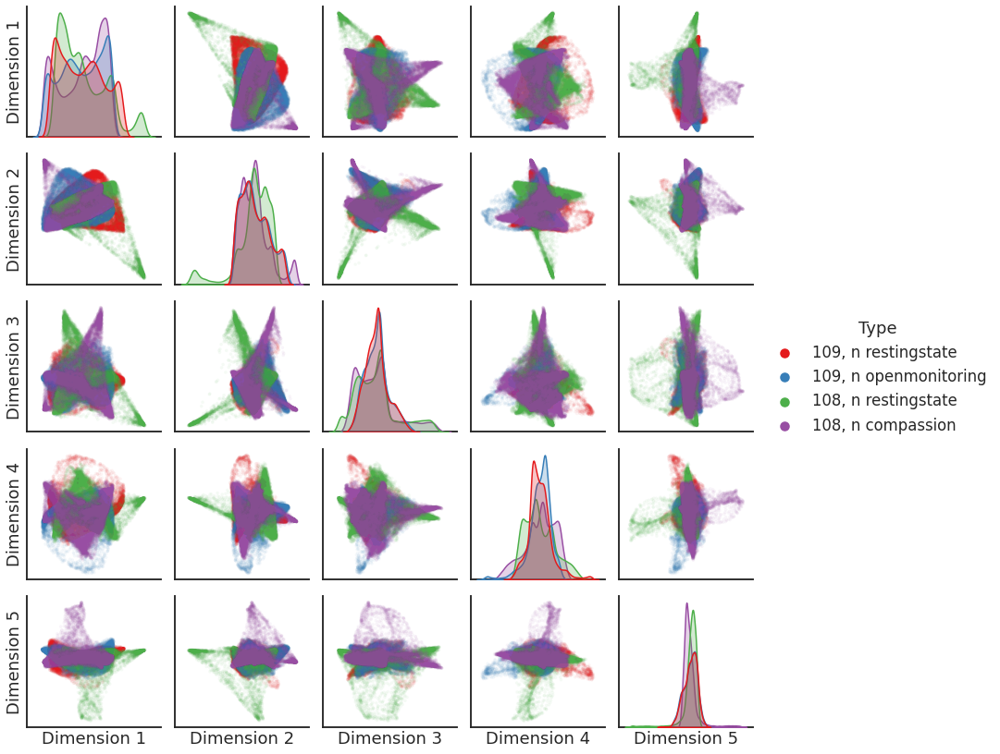

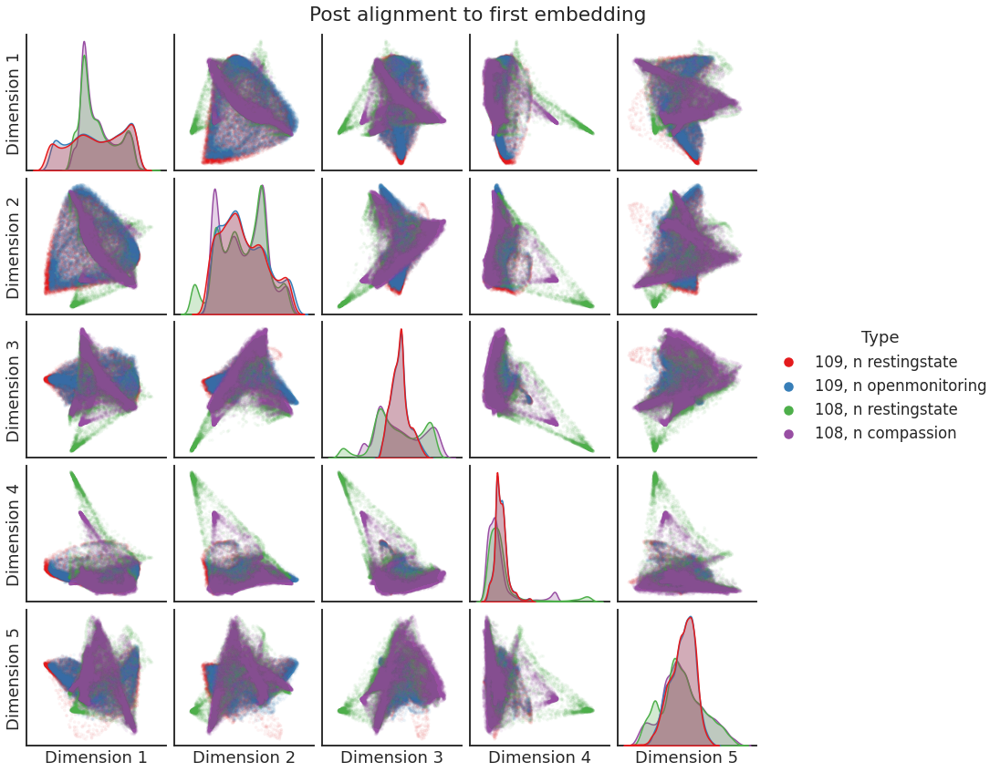

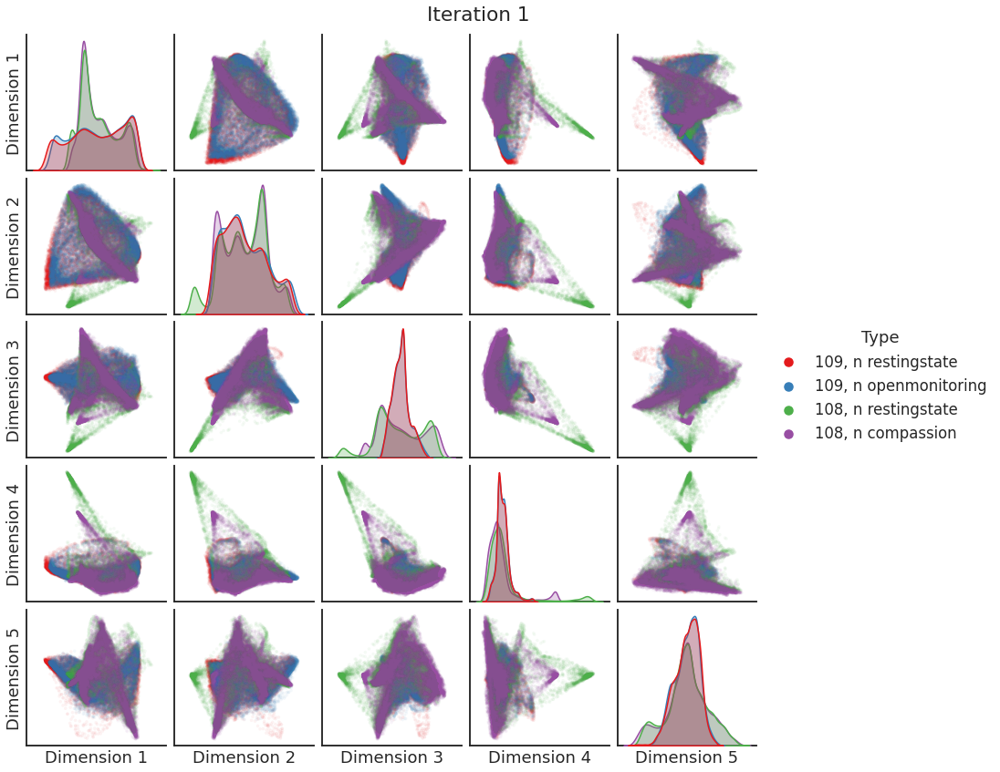

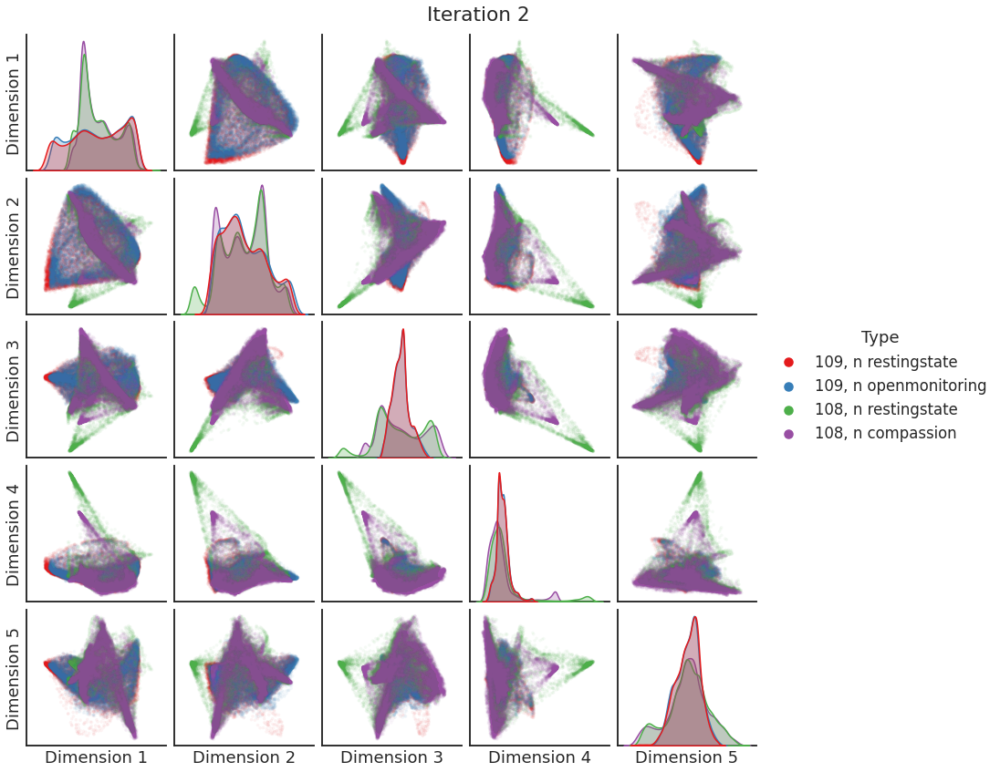

In [81]:
embeddings = Xs

pairplot(np.vstack(embeddings[1:5]), labels=np.hstack([[l]*18715 for l in labels_subj_st[1:5]]), alpha=0.05)

max_iter = 2

embeddings = align(embeddings[1:], embeddings[0], firstpass=True)
pairplot(
    np.vstack(embeddings[1:5]),
    labels=np.hstack([[l]*18715 for l in labels_subj_st[1:5]]),
    alpha=0.05,
    title='Post alignment to first embedding'
)
for i in range(max_iter):
    mean = np.mean(embeddings, axis=0).squeeze()
    embeddings = align(
        embeddings, np.asarray(mean),
        firstpass=False, debug=True)
    pairplot(
        np.vstack(embeddings[1:5]),
        labels=np.hstack([[l]*18715 for l in labels_subj_st[1:5]]),
        alpha=0.05,
        title=f'Iteration {i+1}'
    )

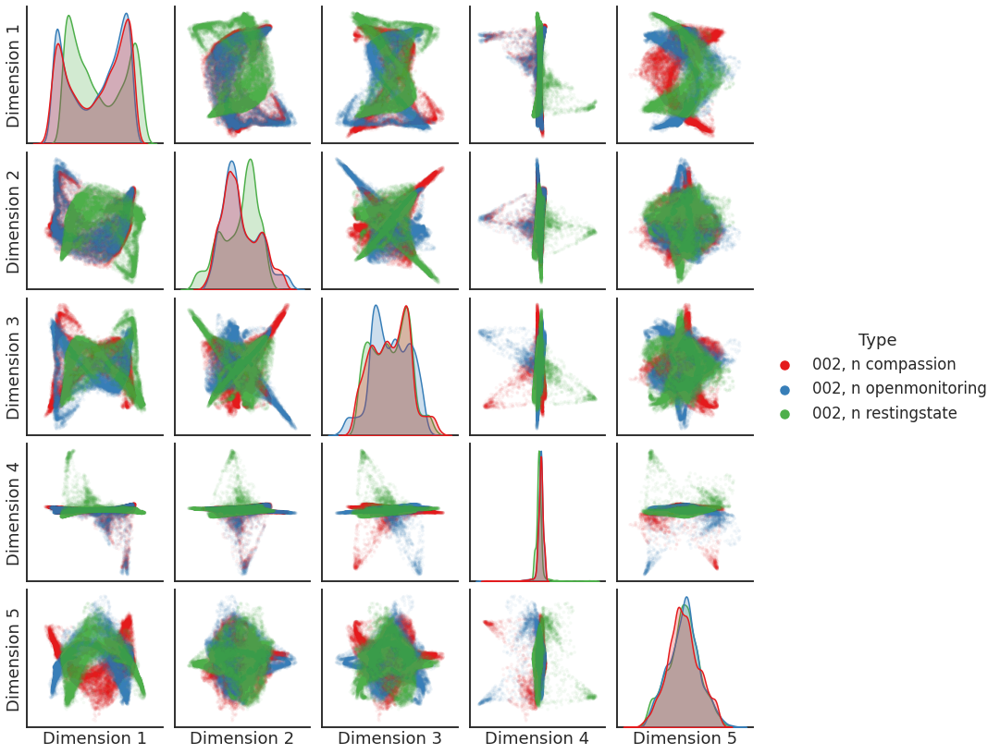

In [54]:
pairplot(np.vstack(Xs[:3]), labels=np.hstack([[l]*18715 for l in labels_subj_st[:3]]), alpha=0.05)

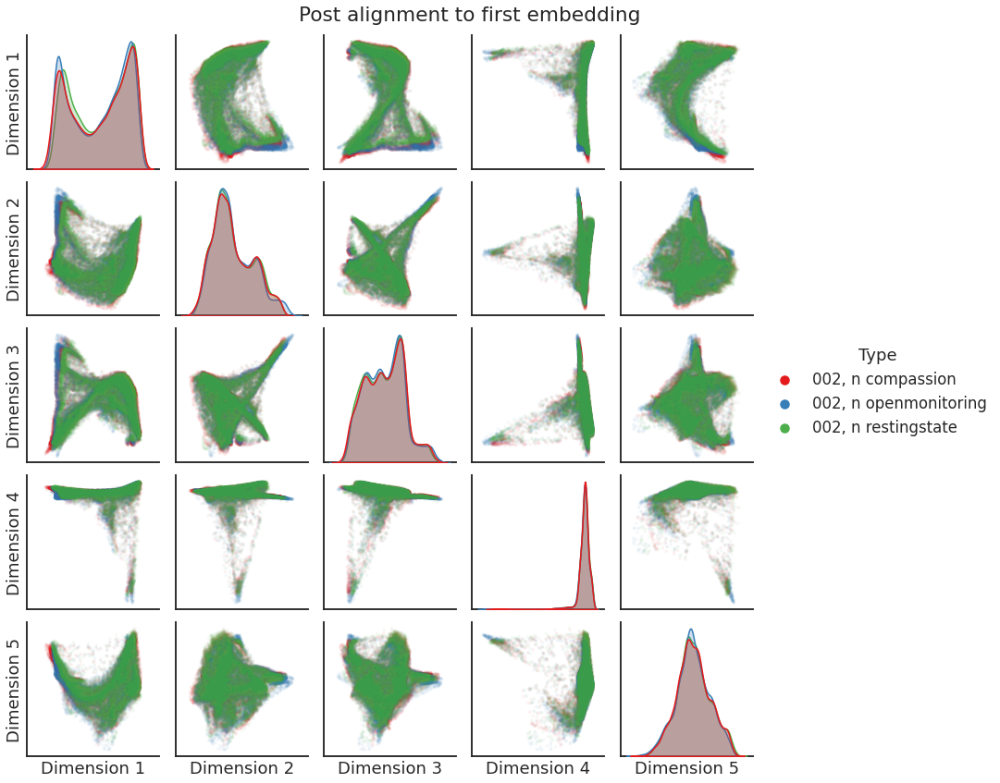

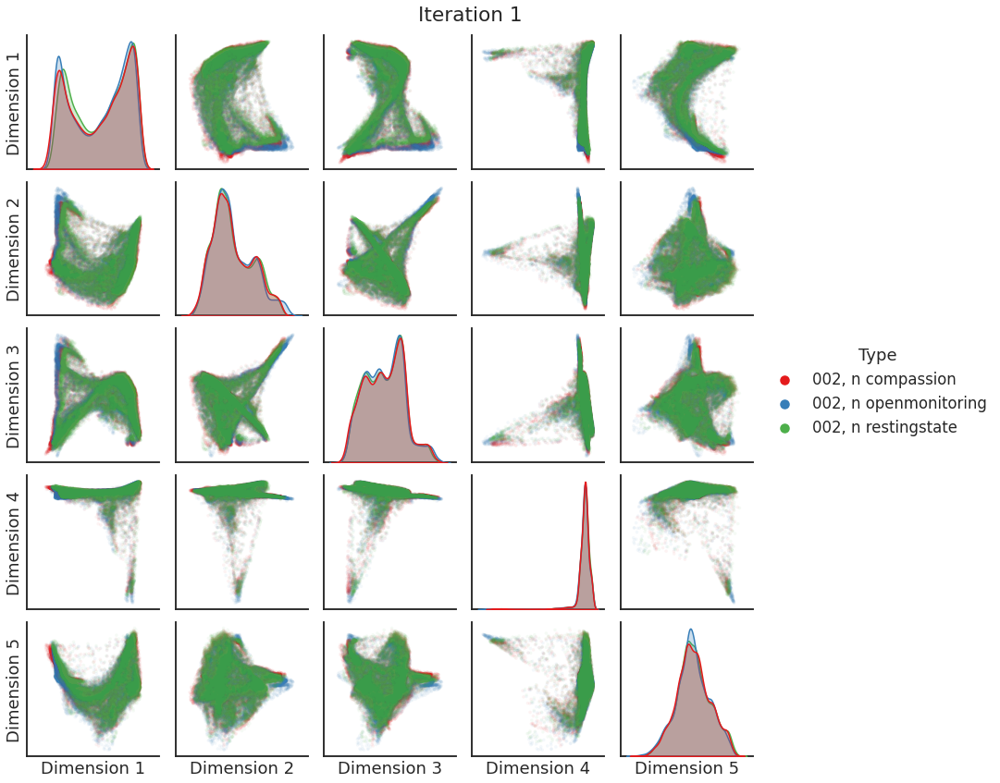

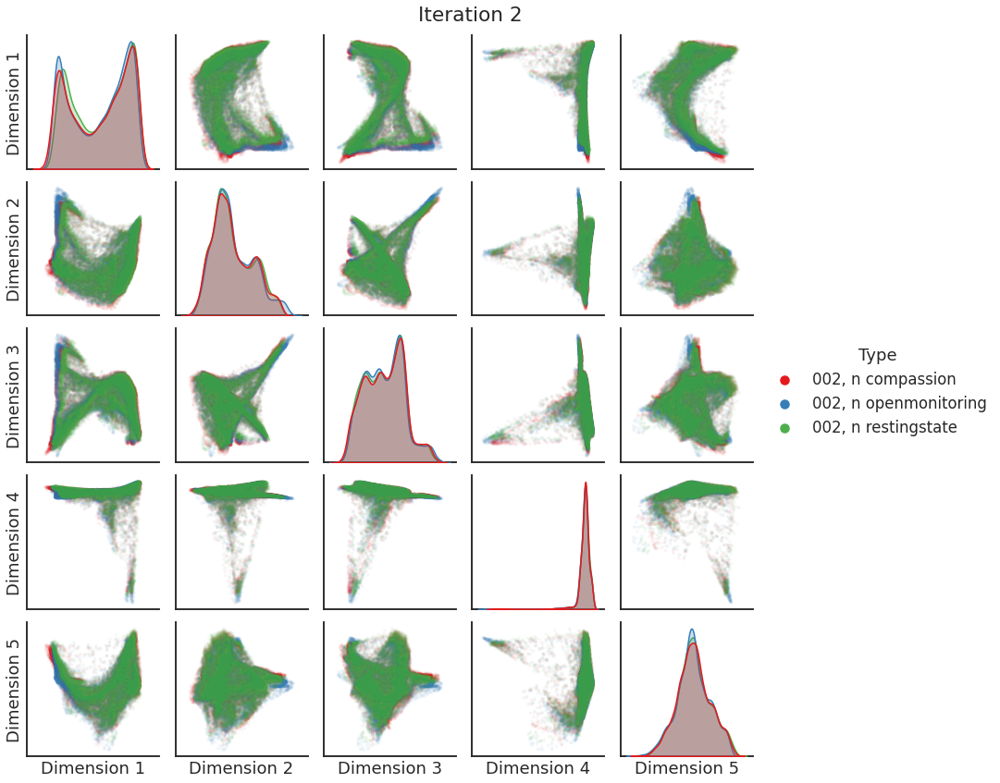

In [55]:
embeddings = Xs
max_iter = 2

embeddings = align(embeddings[1:], embeddings[0], firstpass=True)
pairplot(
    np.vstack(embeddings[:3]),
    labels=np.hstack([[l]*18715 for l in labels_subj_st[:3]]),
    alpha=0.05,
    title='Post alignment to first embedding'
)
for i in range(max_iter):
    mean = np.mean(embeddings, axis=0).squeeze()
    embeddings = align(
        embeddings, np.asarray(mean),
        firstpass=False, debug=True)
    pairplot(
        np.vstack(embeddings[:3]),
        labels=np.hstack([[l]*18715 for l in labels_subj_st[:3]]),
        alpha=0.05,
        title=f'Iteration {i+1}'
    )

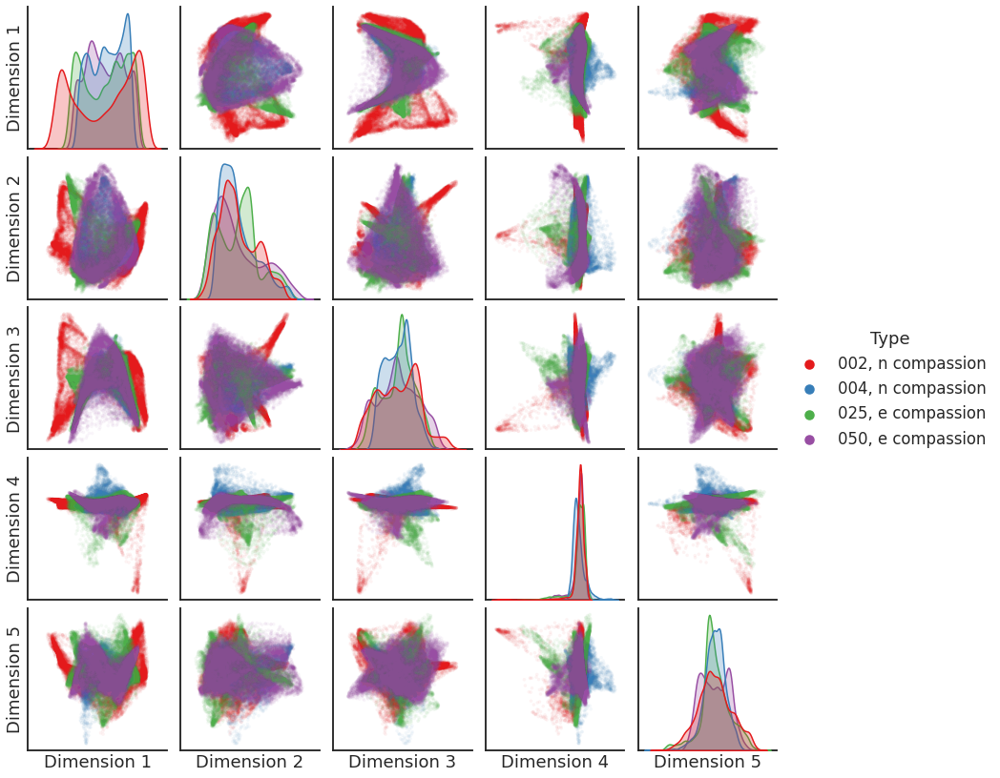

In [71]:
idx = np.hstack((
    np.where(np.asarray(labels_st)=='n compassion')[0][:2],
    np.where(np.asarray(labels_st)=='e compassion')[0][:2]
))
pairplot(np.vstack(Xs[idx]), labels=np.hstack([[l]*18715 for l in np.asarray(labels_subj_st)[idx]]), alpha=0.05)

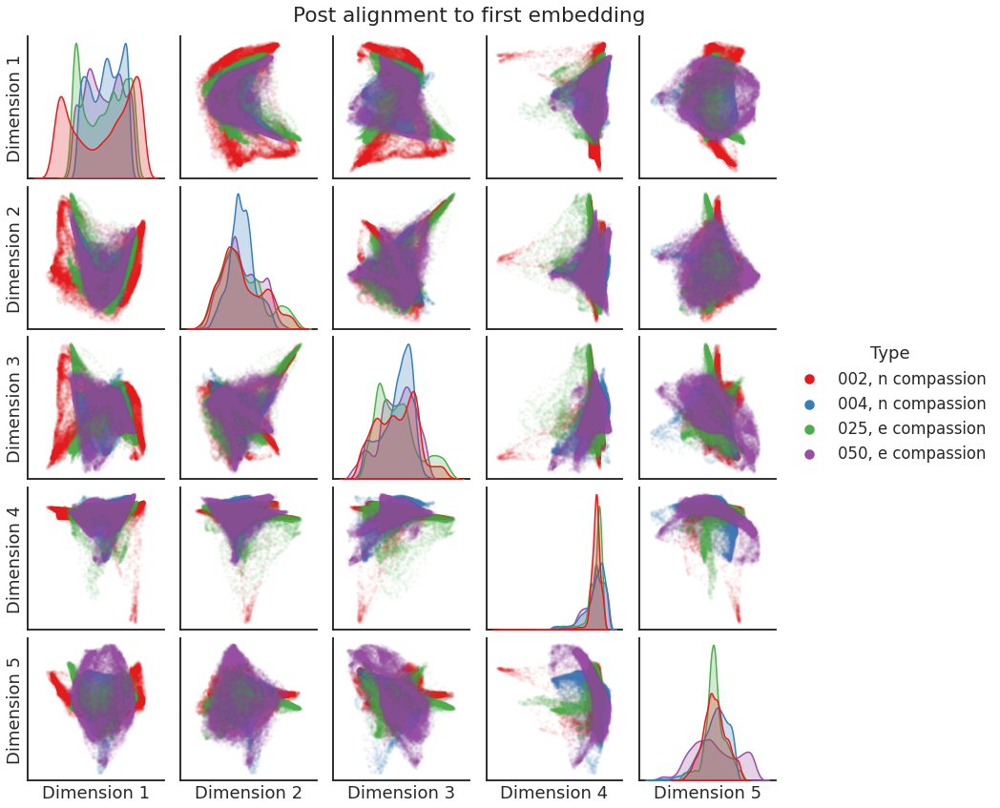

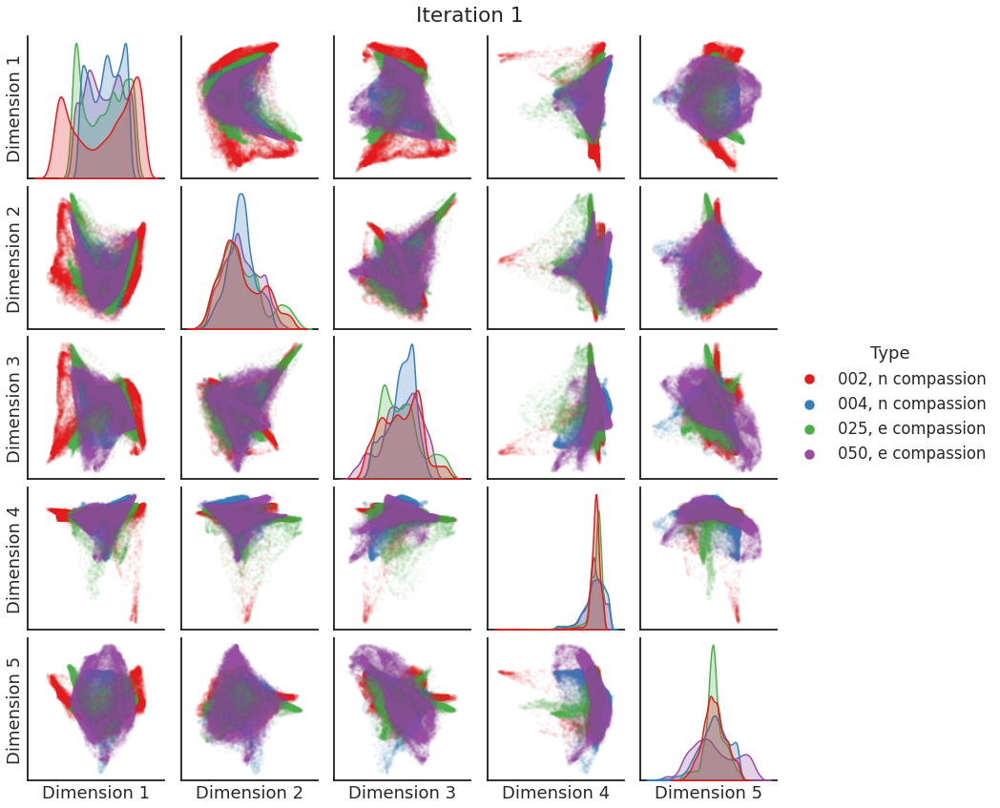

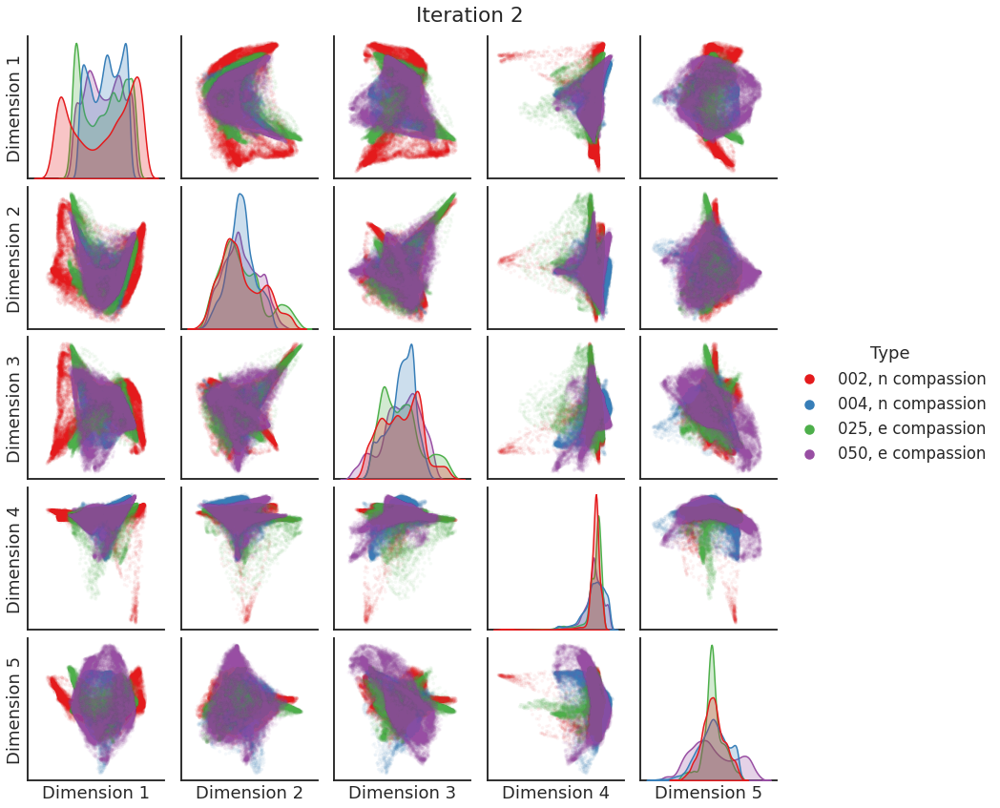

In [74]:
embeddings = Xs
max_iter = 2

embeddings = align(embeddings[1:], embeddings[0], firstpass=True)
embeddings=np.asarray(embeddings)
pairplot(
    np.vstack(embeddings[idx]),
    labels=np.hstack([[l]*18715 for l in np.asarray(labels_subj_st)[idx]]),
    alpha=0.05,
    title='Post alignment to first embedding'
)
for i in range(max_iter):
    mean = np.mean(embeddings, axis=0).squeeze()
    embeddings = align(
        embeddings, np.asarray(mean),
        firstpass=False, debug=True)
    embeddings=np.asarray(embeddings)
    pairplot(
        np.vstack(embeddings[idx]),
        labels=np.hstack([[l]*18715 for l in np.asarray(labels_subj_st)[idx]]),
        alpha=0.05,
        title=f'Iteration {i+1}'
    )

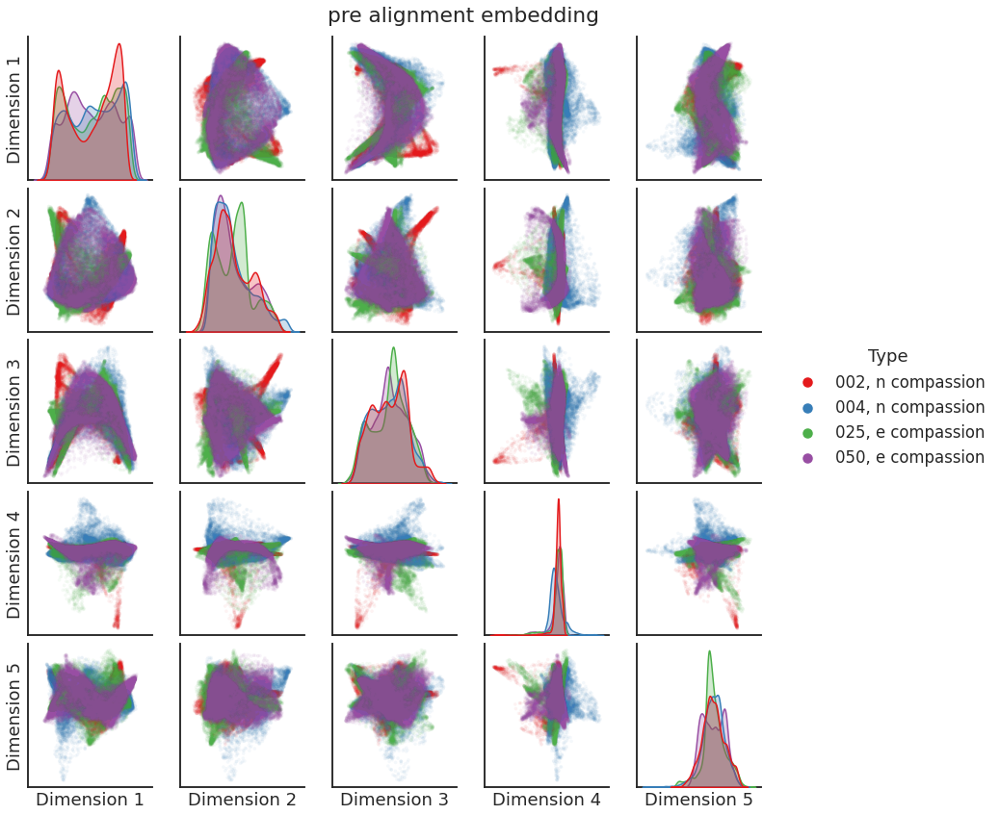

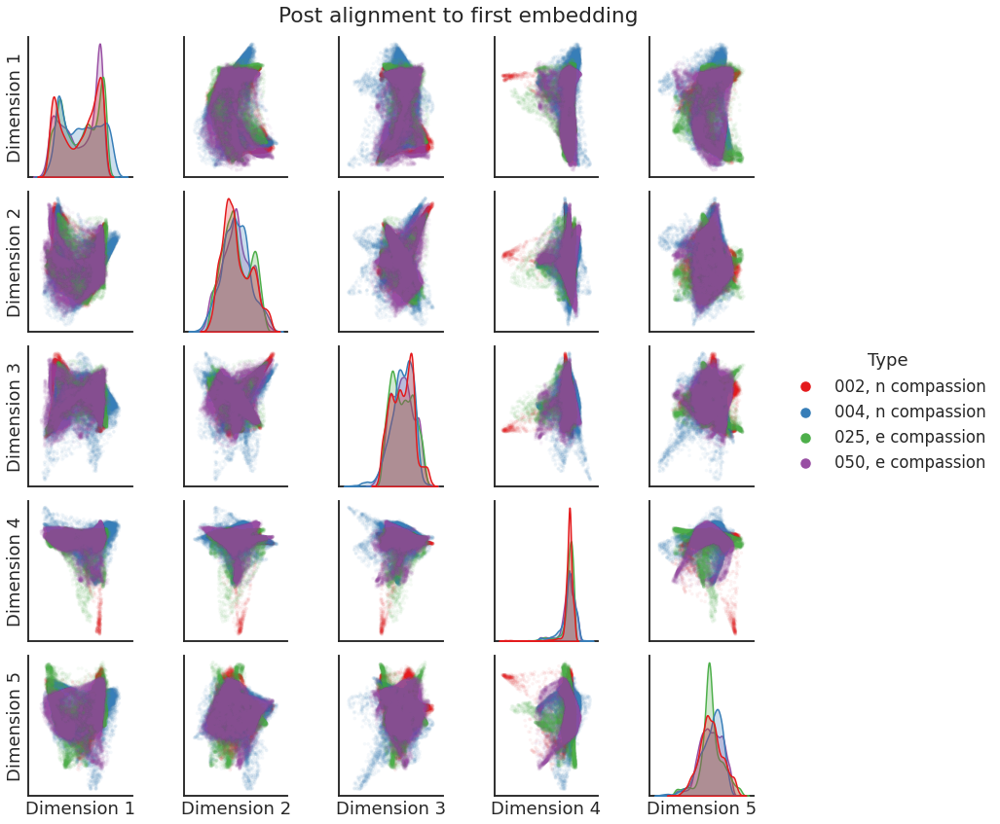

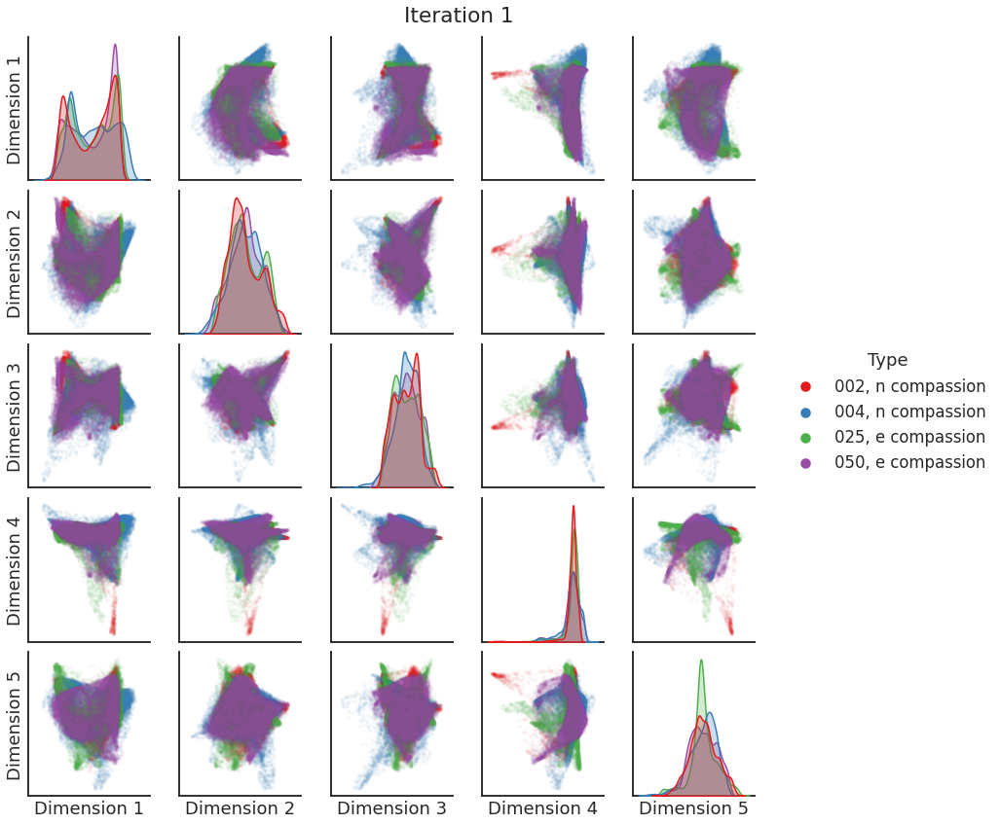

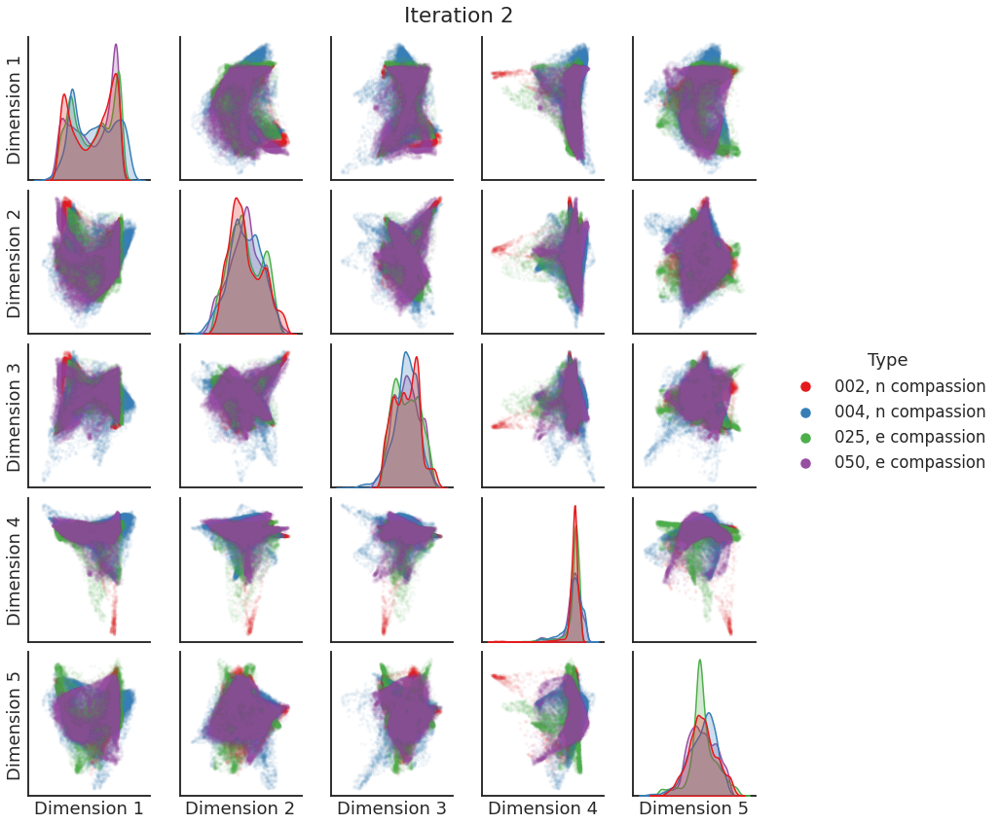

In [75]:
embeddings = Xs
embeddings /=  np.linalg.norm(embeddings, axis=1, keepdims=True)
max_iter = 2

idx = np.hstack((
    np.where(np.asarray(labels_st)=='n compassion')[0][:2],
    np.where(np.asarray(labels_st)=='e compassion')[0][:2]
))
pairplot(
    np.vstack(embeddings[idx]),
    labels=np.hstack([[l]*18715 for l in np.asarray(labels_subj_st)[idx]]),
    alpha=0.05,
    title='pre alignment embedding'
)

embeddings = align(embeddings[1:], embeddings[0], firstpass=True)
embeddings=np.asarray(embeddings)
pairplot(
    np.vstack(embeddings[idx]),
    labels=np.hstack([[l]*18715 for l in np.asarray(labels_subj_st)[idx]]),
    alpha=0.05,
    title='Post alignment to first embedding'
)
for i in range(max_iter):
    mean = np.mean(embeddings, axis=0).squeeze()
    embeddings = align(
        embeddings, np.asarray(mean),
        firstpass=False, debug=True)
    embeddings=np.asarray(embeddings)
    pairplot(
        np.vstack(embeddings[idx]),
        labels=np.hstack([[l]*18715 for l in np.asarray(labels_subj_st)[idx]]),
        alpha=0.05,
        title=f'Iteration {i+1}'
    )

# Replicated dmap, row normed

In [77]:
source_dir = '/mnt/ssd3/ronan/data/dmap_replication_row-normalized_12-16/'
data = 'dmap'
Xs, labels, subjs = load_data(source_dir, data)
print(np.linalg.norm(Xs[1], axis=0))

sort_idx = np.argsort(subjs)
Xs = Xs[sort_idx]
labels = labels[sort_idx]
subjs = subjs[sort_idx]
labels_st = [l[0] + ' ' + l[1] for l in labels]
labels_subj_st = [f'{subj}, {l}' for subj,l in zip(subjs, labels_st)]

[452.49525814 204.13185923 170.23345768 114.37725532 101.93060106]


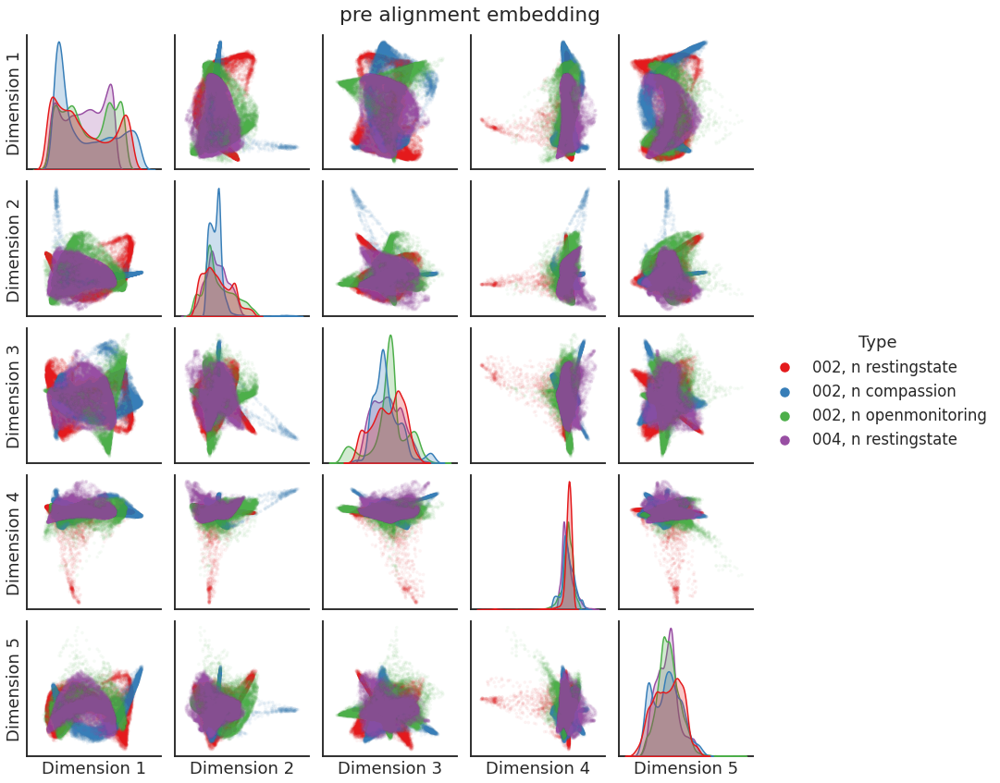

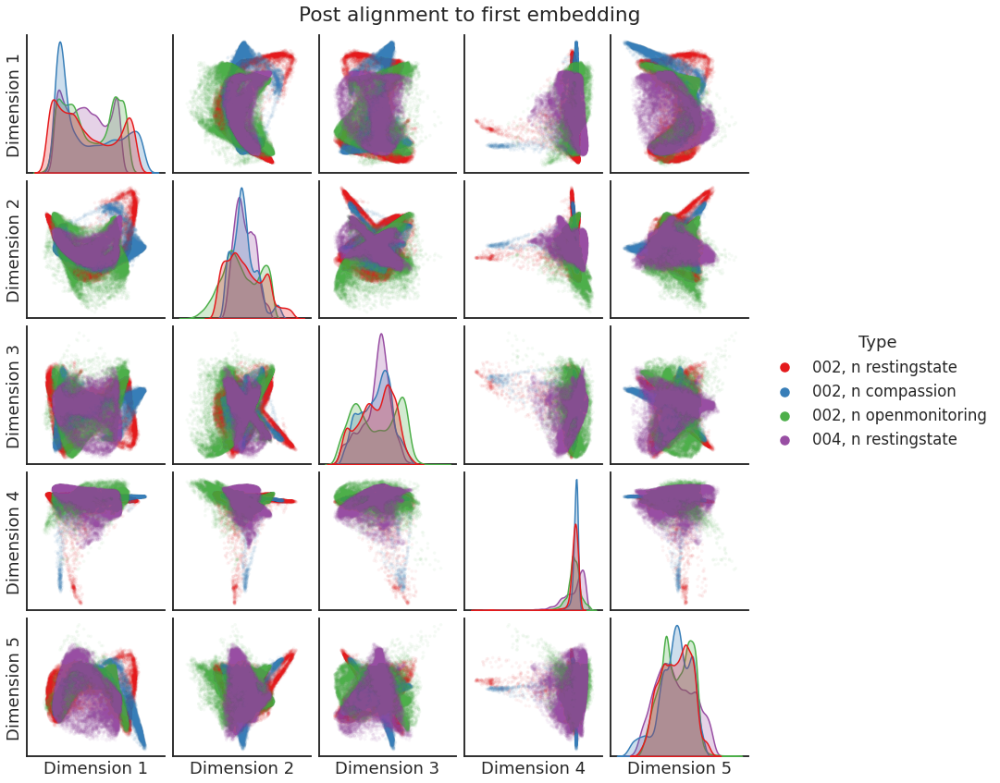

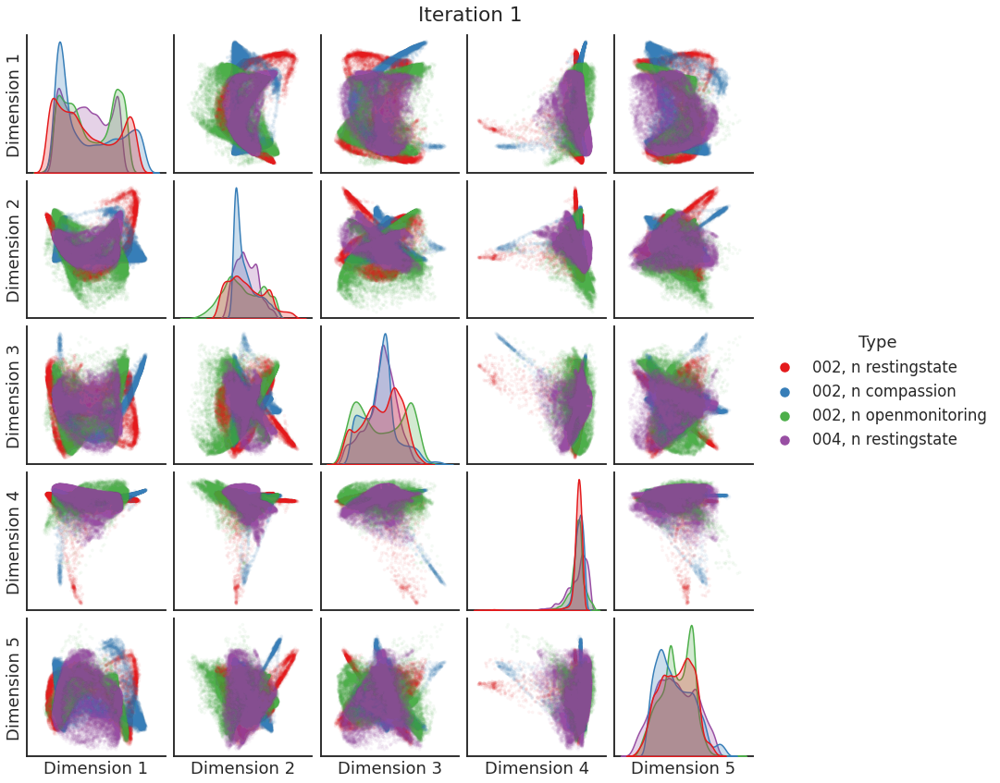

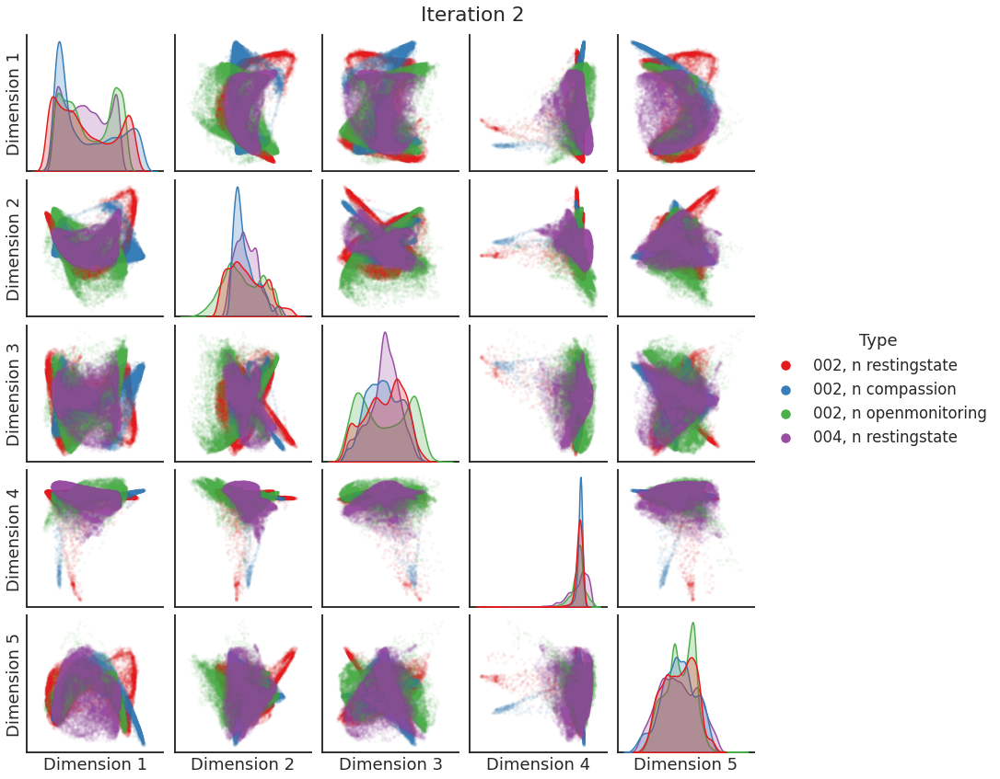

In [78]:
embeddings = Xs
max_iter = 2

idx = np.asarray([0,1,2,3])

# idx = np.hstack((
#     np.where(np.asarray(labels_st)=='n compassion')[0][:2],
#     np.where(np.asarray(labels_st)=='e compassion')[0][:2]
# ))

pairplot(
    np.vstack(embeddings[idx]),
    labels=np.hstack([[l]*18715 for l in np.asarray(labels_subj_st)[idx]]),
    alpha=0.05,
    title='pre alignment embedding'
)

embeddings = align(embeddings[1:], embeddings[0], firstpass=True)
embeddings=np.asarray(embeddings)
pairplot(
    np.vstack(embeddings[idx]),
    labels=np.hstack([[l]*18715 for l in np.asarray(labels_subj_st)[idx]]),
    alpha=0.05,
    title='Post alignment to first embedding'
)
for i in range(max_iter):
    mean = np.mean(embeddings, axis=0).squeeze()
    embeddings = align(
        embeddings, np.asarray(mean),
        firstpass=False, debug=True)
    embeddings=np.asarray(embeddings)
    pairplot(
        np.vstack(embeddings[idx]),
        labels=np.hstack([[l]*18715 for l in np.asarray(labels_subj_st)[idx]]),
        alpha=0.05,
        title=f'Iteration {i+1}'
    )

# Gcca gradients

In [20]:
source_dir = '/mnt/ssd3/ronan/data/gcca_raw_ZG3-max_12-09'
data = 'gcca'
Xs, labels, subjs = load_data(source_dir, data)
print(np.linalg.norm(Xs[1], axis=0))

sort_idx = np.argsort(subjs)
Xs = Xs[sort_idx]
labels = labels[sort_idx]
subjs = subjs[sort_idx]
labels_st = [l[0] + ' ' + l[1] for l in labels]
labels_subj_st = [f'{subj}, {l}' for subj,l in zip(subjs, labels_st)]

[14.96666836 14.96666592 14.96664439 14.96664282 14.96663695 14.96663857
 14.96677972 14.96671346 14.96680984]


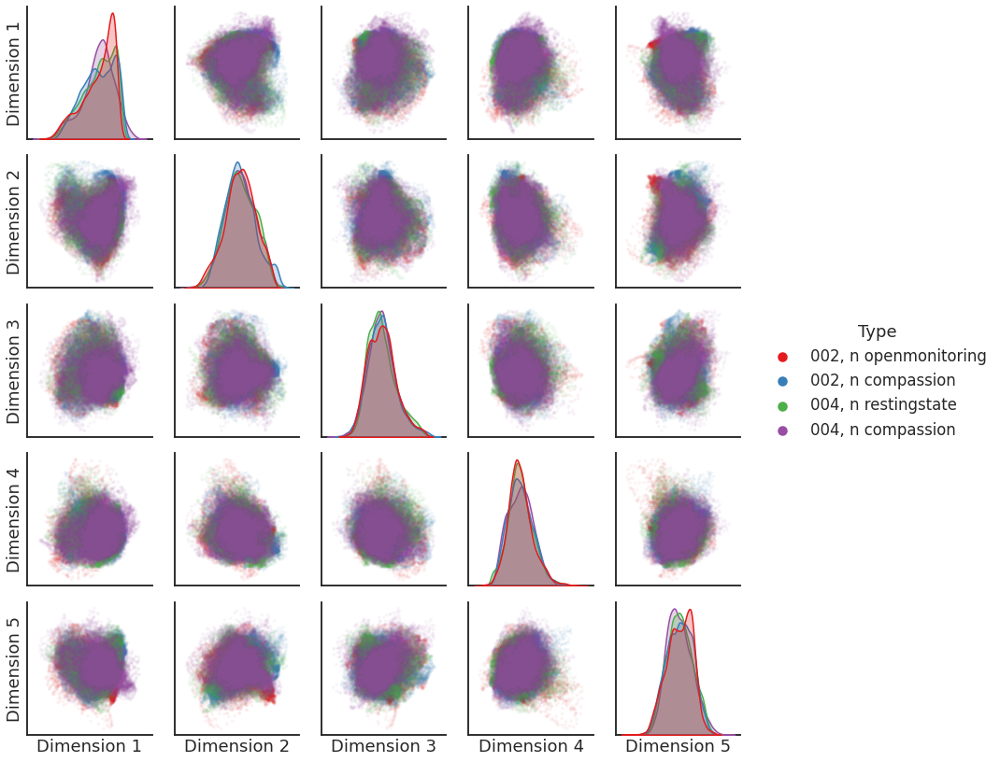

In [21]:
embeddings = Xs[:, :, :5]
pairplot(np.vstack(embeddings[1:5]), labels=np.hstack([[l]*18715 for l in labels_subj_st[1:5]]), alpha=0.05)

# MASE

In [91]:
source_dir = '/mnt/ssd3/ronan/data/mase_dmap_11-16'
data = 'mase_dmap'
Xs, labels, subjs = load_data(source_dir, data)
Xs = Xs[:,:,:5]
print(np.linalg.norm(Xs[1], axis=0))
sort_idx = np.argsort(subjs)
Xs = Xs[sort_idx]
labels = labels[sort_idx]
subjs = subjs[sort_idx]
labels_st = [l[0] + ' ' + l[1] for l in labels]
labels_subj_st = [f'{subj}, {l}' for subj,l in zip(subjs, labels_st)]

[1.00445568 0.56667683 0.4709068  0.30616944 0.27776833]


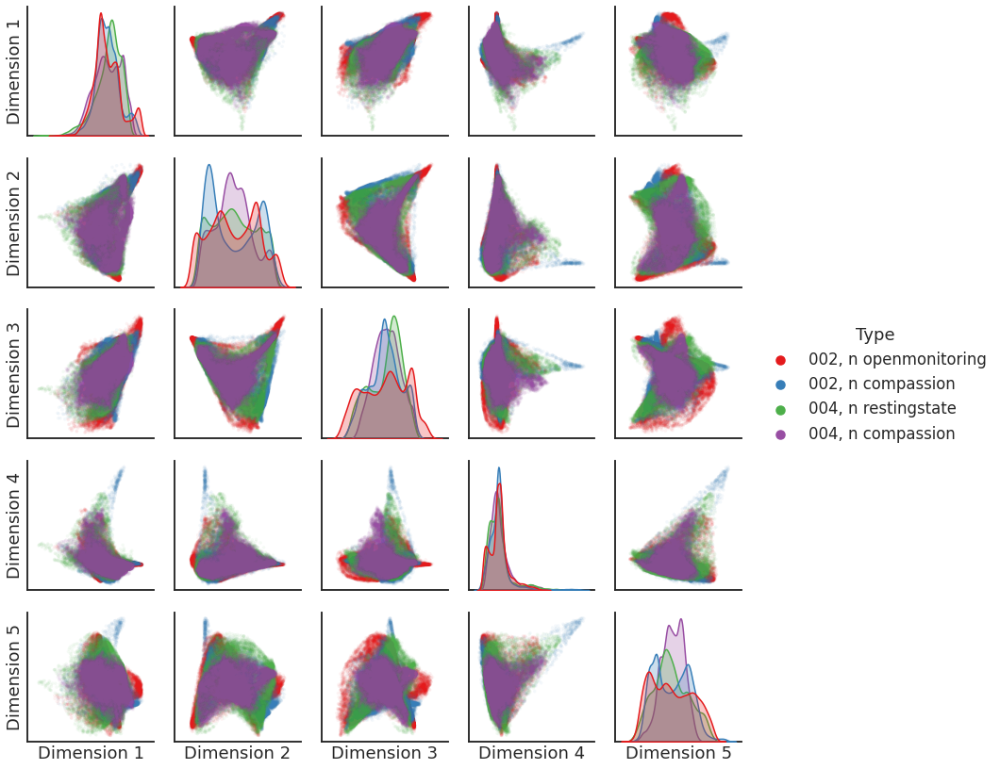

In [92]:
pairplot(np.vstack(Xs[1:5]), labels=np.hstack([[l]*18715 for l in labels_subj_st[1:5]]), alpha=0.05)

In [94]:
source_dir = '/mnt/ssd3/ronan/data/mase_dmap_meaned_11-23'
data = 'mase'
Xs, labels, subjs = load_data(source_dir, data)
Xs = Xs[:,:,:5]
print(np.linalg.norm(Xs[1], axis=0))
sort_idx = np.argsort(subjs)
Xs = Xs[sort_idx]
labels = labels[sort_idx]
subjs = subjs[sort_idx]
labels_st = [l[0] + ' ' + l[1] for l in labels]
labels_subj_st = [f'{subj}, {l}' for subj,l in zip(subjs, labels_st)]

[0.24860713 0.25365948 0.21403101 0.21052716 0.18961913]


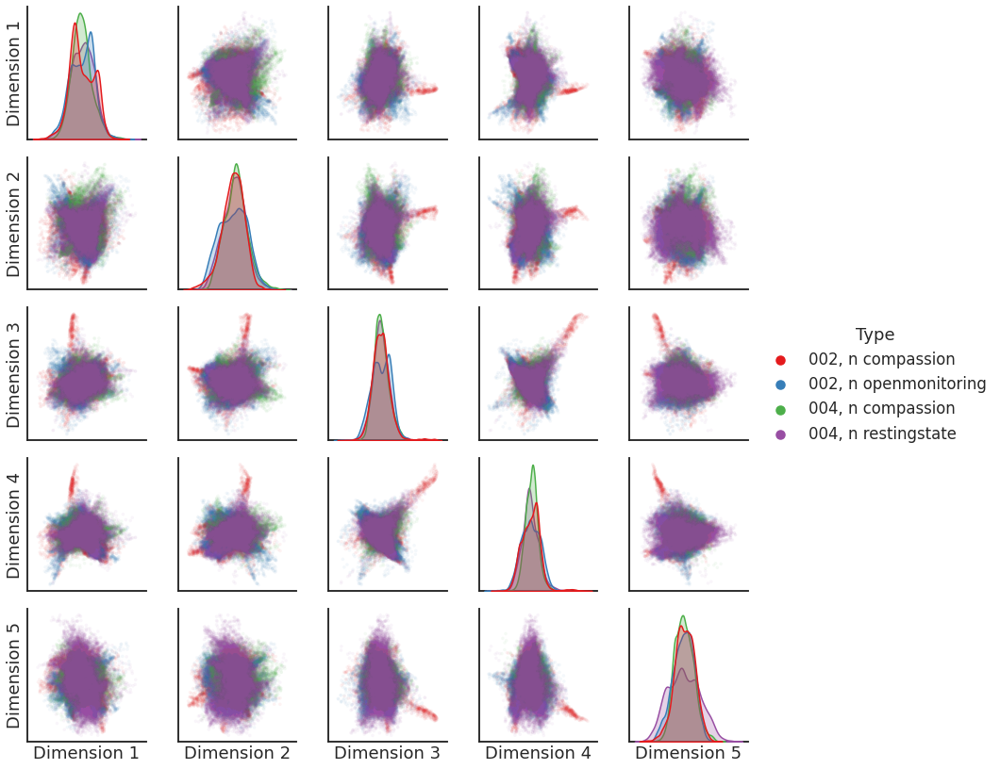

In [95]:
pairplot(np.vstack(Xs[1:5]), labels=np.hstack([[l]*18715 for l in labels_subj_st[1:5]]), alpha=0.05)

In [96]:
source_dir = '/mnt/ssd3/ronan/data/gcca_dmap_ZG2_12-04'
data = 'gcca'
Xs, labels, subjs = load_data(source_dir, data)
Xs = Xs[:,:,:5]
print(np.linalg.norm(Xs[1], axis=0))
sort_idx = np.argsort(subjs)
Xs = Xs[sort_idx]
labels = labels[sort_idx]
subjs = subjs[sort_idx]
labels_st = [l[0] + ' ' + l[1] for l in labels]
labels_subj_st = [f'{subj}, {l}' for subj,l in zip(subjs, labels_st)]

[14.96662955 14.96662955 14.96662955 14.96662955]


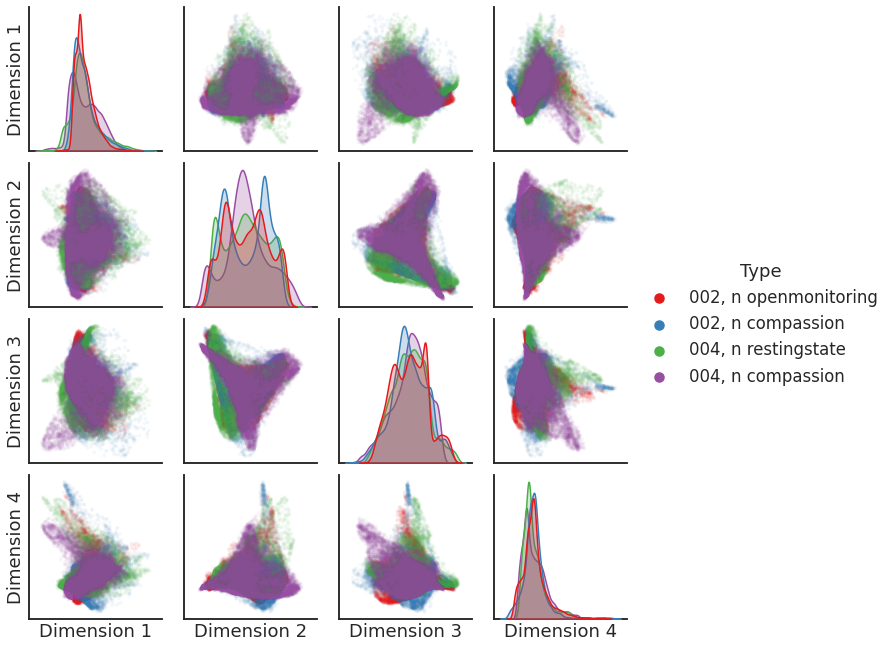

In [97]:
pairplot(np.vstack(Xs[1:5]), labels=np.hstack([[l]*18715 for l in labels_subj_st[1:5]]), alpha=0.05)

In [98]:
source_dir = '/mnt/ssd3/ronan/data/gcca_dmap_centered_ZG3_12-03'
data = 'gcca'
Xs, labels, subjs = load_data(source_dir, data)
Xs = Xs[:,:,:5]
print(np.linalg.norm(Xs[1], axis=0))
sort_idx = np.argsort(subjs)
Xs = Xs[sort_idx]
labels = labels[sort_idx]
subjs = subjs[sort_idx]
labels_st = [l[0] + ' ' + l[1] for l in labels]
labels_subj_st = [f'{subj}, {l}' for subj,l in zip(subjs, labels_st)]

[14.96662955 14.96662955 14.96662955 14.96662955 14.96662955]


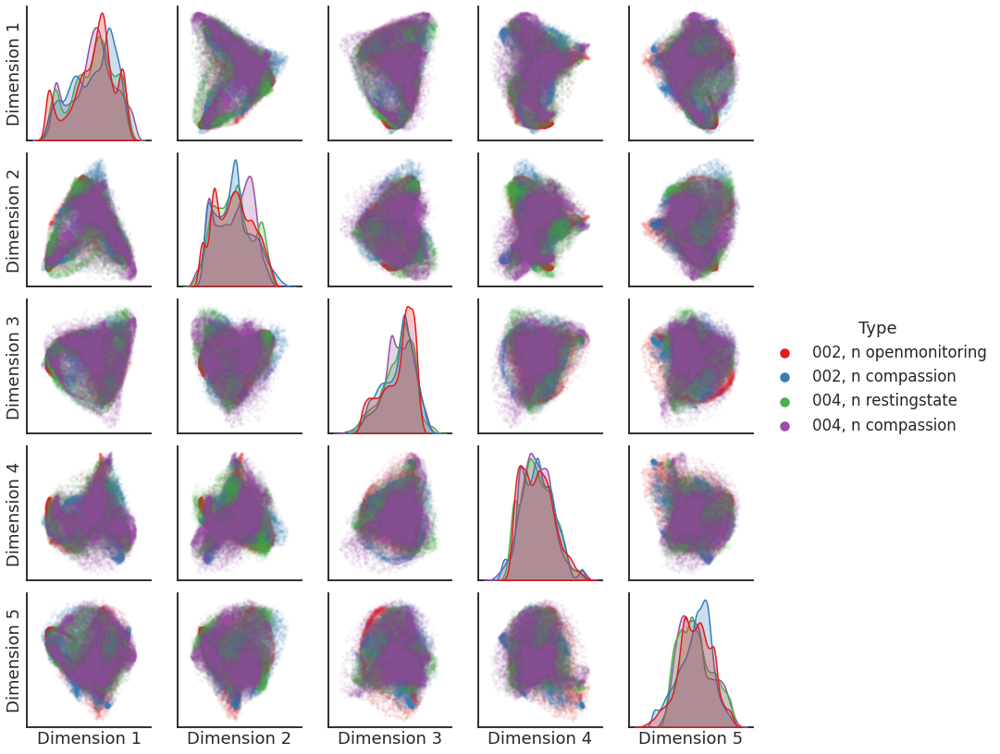

In [99]:
pairplot(np.vstack(Xs[1:5]), labels=np.hstack([[l]*18715 for l in labels_subj_st[1:5]]), alpha=0.05)

# MASE o dmap (antoinne data)

In [100]:
from graspologic.embed import selectSVD

In [103]:
source_dir = '/mnt/ssd3/ronan/data/dmap_antoinne_09-04'
data = 'antoine'
Xs, labels, subjs = load_data(source_dir, data)
print(np.linalg.norm(Xs[1], axis=0))

sort_idx = np.argsort(subjs)[::-1]
Xs = Xs[sort_idx]
labels = labels[sort_idx]
subjs = subjs[sort_idx]
labels_st = [l[0] + ' ' + l[1] for l in labels]
labels_subj_st = [f'{subj}, {l}' for subj,l in zip(subjs, labels_st)]

[252.59346  246.74161  168.04521  123.80227   92.611305]


In [108]:
Uhat, sing_vals_left, _ = selectSVD(
    np.hstack(Xs),
    n_components=5,
    n_elbows=2,
    algorithm="randomized",
    n_iter=5,
)

In [120]:
Xs2 = np.asarray((Xs[0] / np.linalg.norm(Xs[0], axis=0), Uhat))
embs, _, _ = iterate_align(
    Xs2, _, _, thresh=0, max_iter=5, norm=False
)

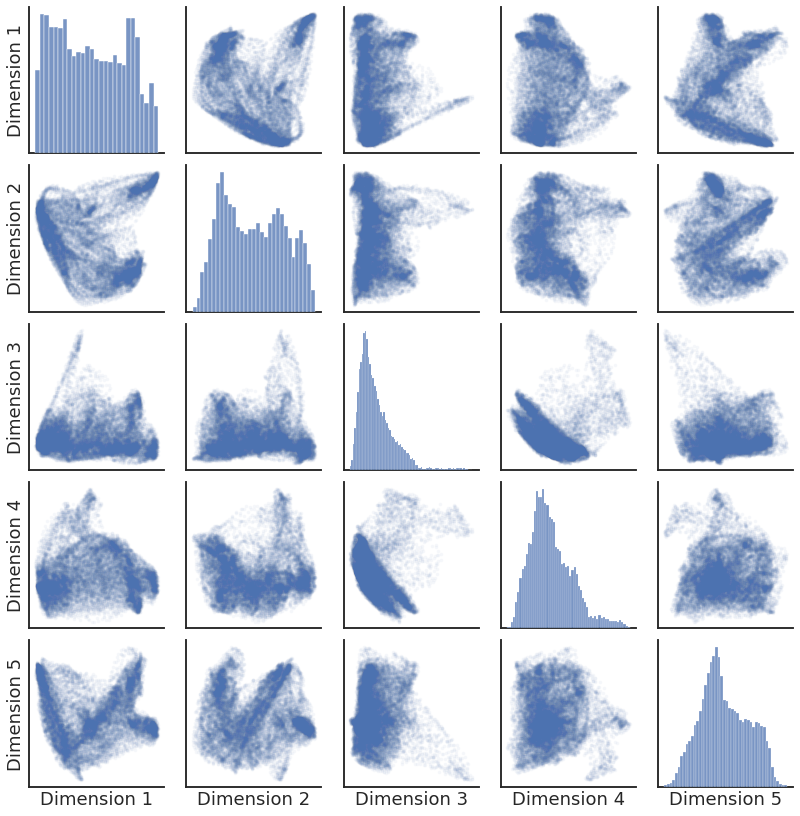

In [123]:
pairplot(
    Uhat,
    # labels=np.hstack(([0]*18715, [1]*18715)),
    alpha=0.05)

## Antoinne aligned, centered

In [22]:
source_dir = '/mnt/ssd3/ronan/data/dmap_antoinne_09-04'
data = 'antoine'
Xs, labels, subjs = load_data(source_dir, data)
print(np.linalg.norm(Xs[1], axis=0))

sort_idx = np.argsort(subjs)[::-1]
Xs = Xs[sort_idx]
labels = labels[sort_idx]
subjs = subjs[sort_idx]
labels_st = [l[0] + ' ' + l[1] for l in labels]
labels_subj_st = [f'{subj}, {l}' for subj,l in zip(subjs, labels_st)]

[252.59346  246.74161  168.04521  123.80227   92.611305]


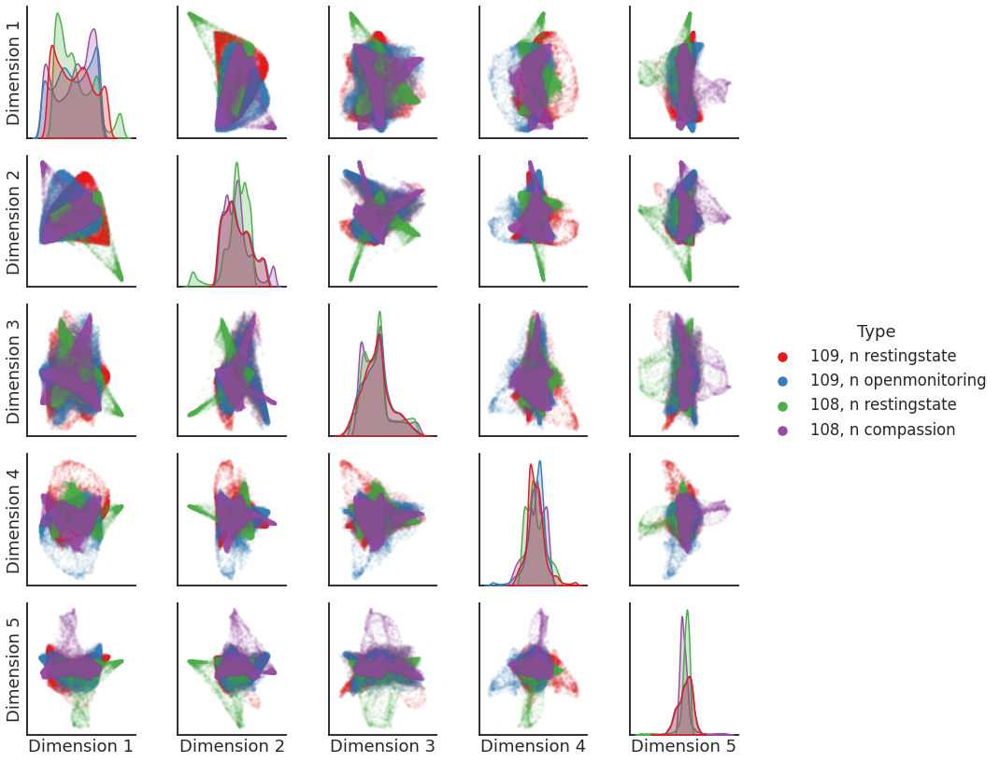

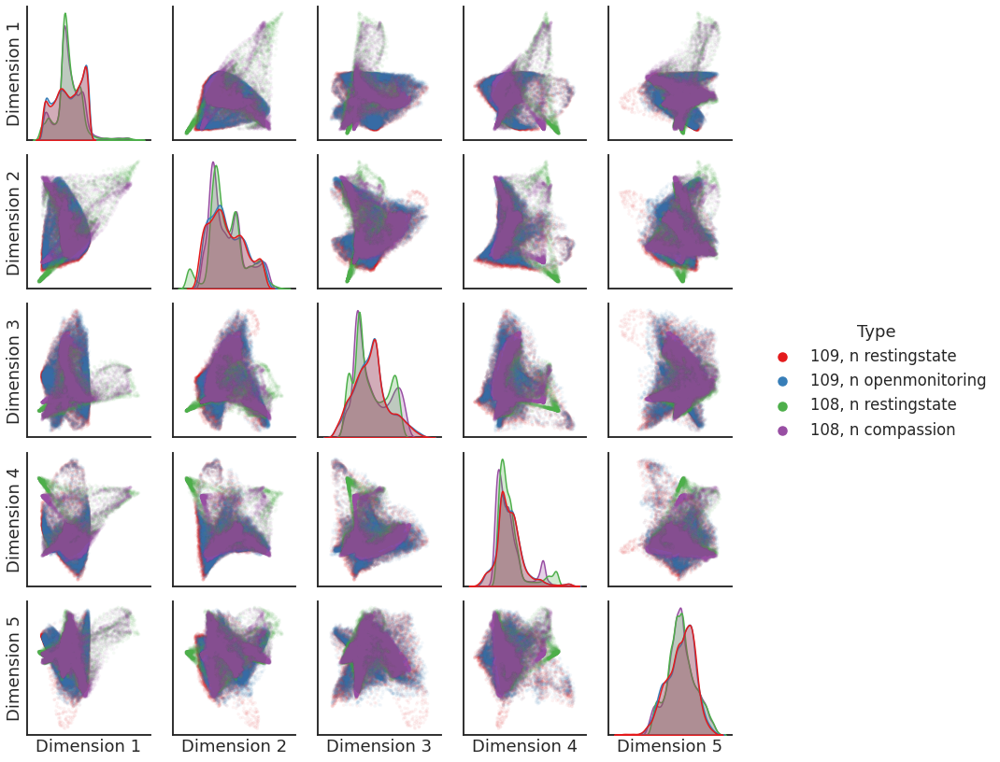

In [27]:
embeddings = Xs / np.linalg.norm(Xs, axis=1, keepdims=True)

pairplot(np.vstack(embeddings[1:5]), labels=np.hstack([[l]*18715 for l in labels_subj_st[1:5]]), alpha=0.05)

max_iter = 5

embeddings = align(embeddings[1:], embeddings[0], firstpass=True)
# pairplot(
#     np.vstack(embeddings[1:5]),
#     labels=np.hstack([[l]*18715 for l in labels_subj_st[1:5]]),
#     alpha=0.05,
#     title='Post alignment to first embedding'
# )
for i in range(max_iter):
    mean = np.mean(embeddings, axis=0).squeeze()
    embeddings = align(
        embeddings, np.asarray(mean),
        firstpass=False, debug=True)
pairplot(
    np.vstack(embeddings[1:5]),
    labels=np.hstack([[l]*18715 for l in labels_subj_st[1:5]]),
    alpha=0.05,
    title=f''
)

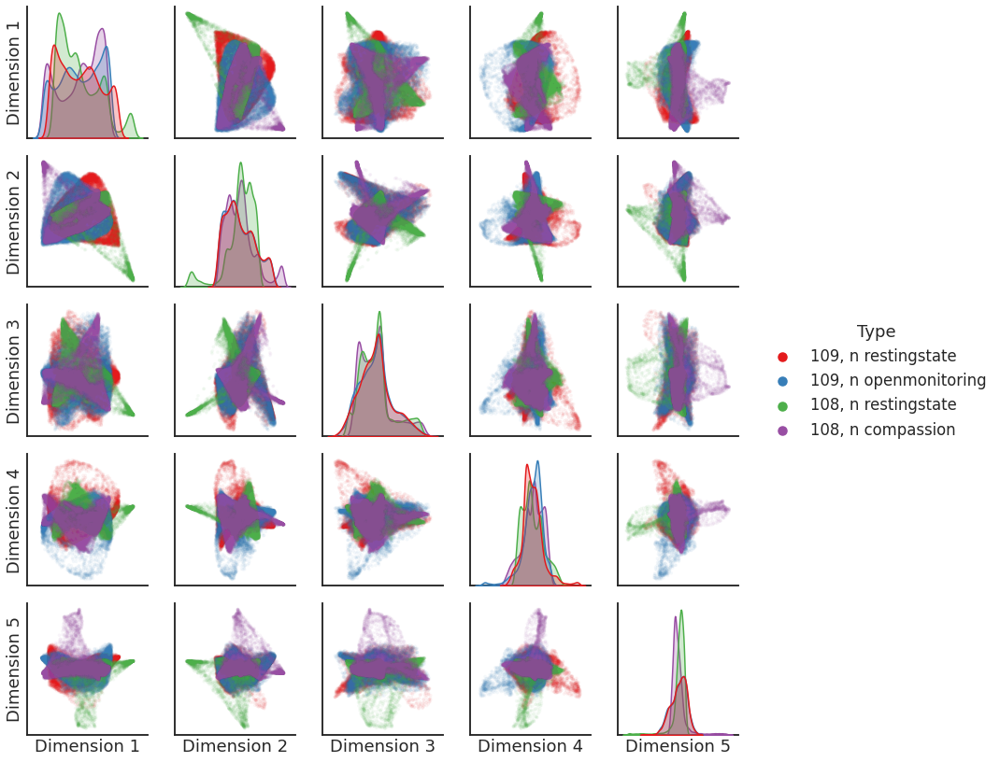

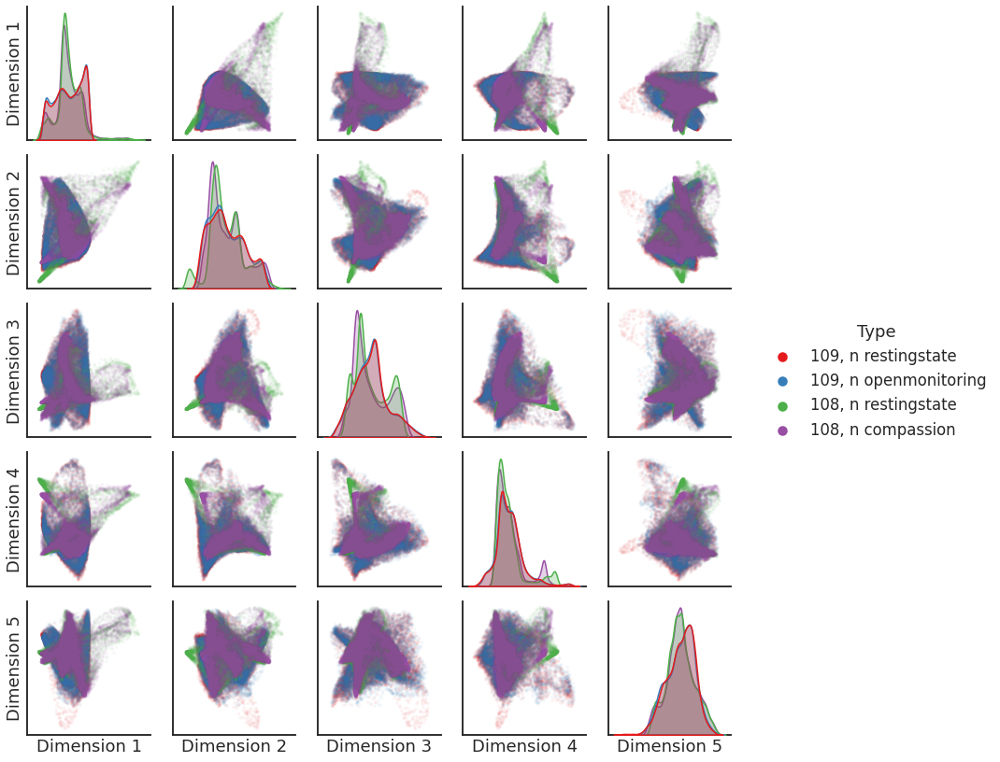

In [28]:
embeddings = Xs - np.mean(Xs, axis=1, keepdims=True)
embeddings = embeddings / np.linalg.norm(embeddings, axis=1, keepdims=True)

pairplot(np.vstack(embeddings[1:5]), labels=np.hstack([[l]*18715 for l in labels_subj_st[1:5]]), alpha=0.05)

max_iter = 5

embeddings = align(embeddings[1:], embeddings[0], firstpass=True)
# pairplot(
#     np.vstack(embeddings[1:5]),
#     labels=np.hstack([[l]*18715 for l in labels_subj_st[1:5]]),
#     alpha=0.05,
#     title='Post alignment to first embedding'
# )
for i in range(max_iter):
    mean = np.mean(embeddings, axis=0).squeeze()
    embeddings = align(
        embeddings, np.asarray(mean),
        firstpass=False, debug=True)
pairplot(
    np.vstack(embeddings[1:5]),
    labels=np.hstack([[l]*18715 for l in labels_subj_st[1:5]]),
    alpha=0.05,
    title=f''
)

## MASE o aff

In [48]:
source_dir = '/mnt/ssd3/ronan/data/mase_aff_01-05'
data = 'mase'
scores, labels, subjs = load_data(source_dir, data, key='latent')
left_latents, _, _ = load_data(source_dir, data, key='latent_left')
ll = left_latents[0]
scores = scores[:, :, :5]

Xs = scores #ll @ ll.T @ scores

print(np.linalg.norm(Xs[1], axis=0))

sort_idx = np.argsort(subjs)[::-1]
Xs = Xs[sort_idx]
labels = labels[sort_idx]
subjs = subjs[sort_idx]
labels_st = [l[0] + ' ' + l[1] for l in labels]
labels_subj_st = [f'{subj}, {l}' for subj,l in zip(subjs, labels_st)]

[1603.88255252 1058.50234867  779.26373964  580.47180639  315.93911554]


<Figure size 432x288 with 0 Axes>

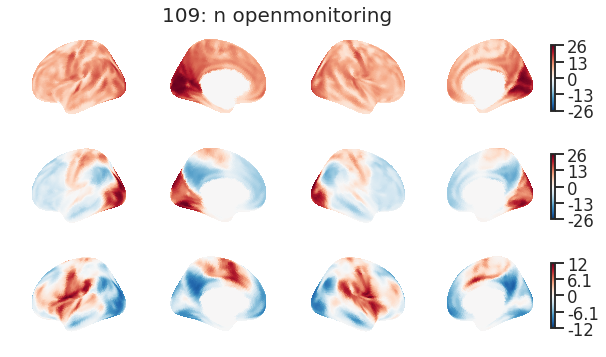

In [49]:
n_embed = 3
for X, subj, (trait, state) in zip(Xs, subjs, labels):
    title = f'{subj}: {trait} {state}'
    fig = visualize_embeddings(
        X[:, :n_embed],
        save_path=False,
        colorbar=True,
        n_embed=n_embed,
        # vmax=vmax,
        title=title,
    )
    plt.show()
    break

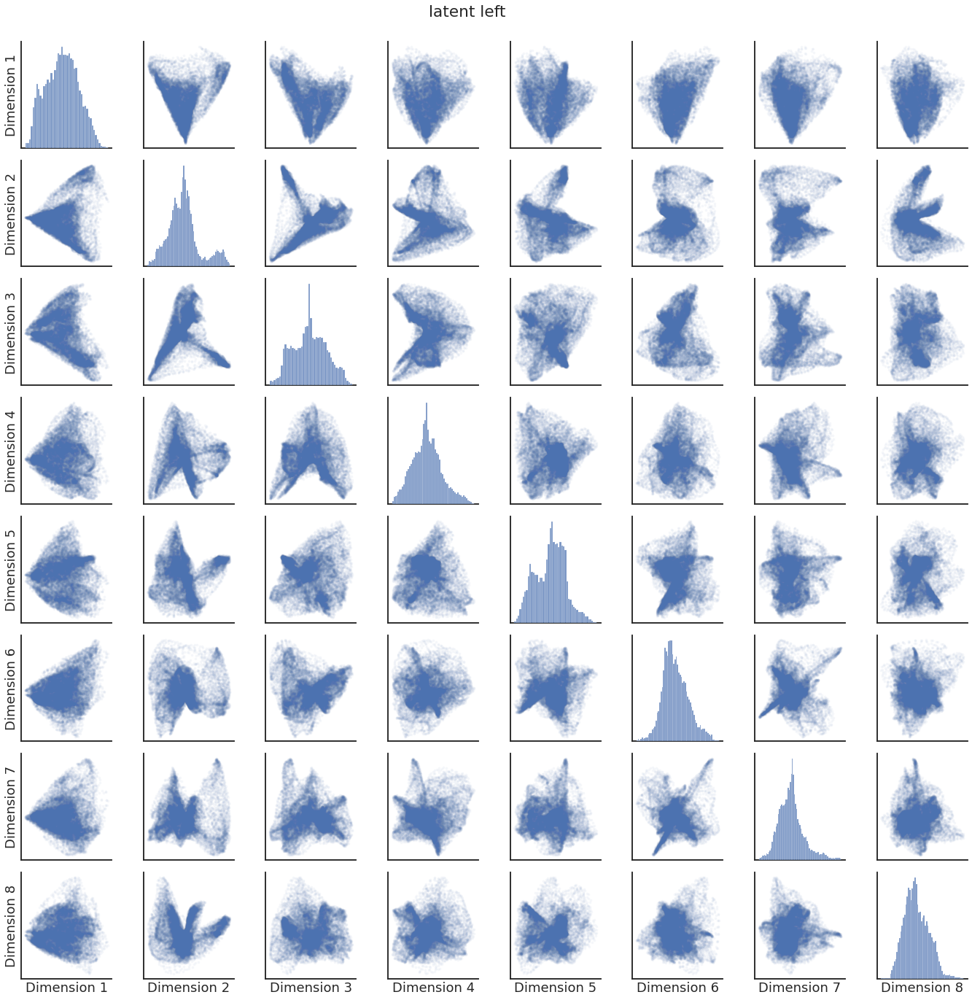

In [26]:
pairplot(
    ll,
    alpha=0.05,
    title=f'latent left'
)

/home/rflperry/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:11: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations. 
  # This is added back by InteractiveShellApp.init_path()


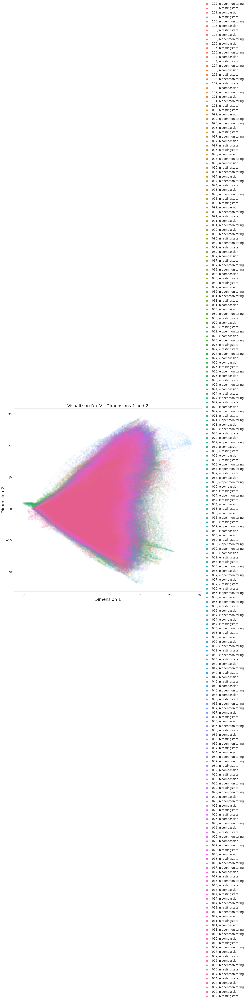

In [24]:
cat = np.concatenate(Xs)

fig, ax = plt.subplots(figsize=(20, 20))

sns.scatterplot(
    x= cat[:, 0], y = cat[:, 1], hue=np.repeat(labels_subj_st, 18715), linewidth=0, alpha = 0.05, ax = ax)
ax.set_title("Visualizing R x V - Dimensions 1 and 2", fontsize=25)
ax.set_xlabel("Dimension 1", fontsize=25)
ax.set_ylabel("Dimension 2", fontsize=25)
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))
plt.show()

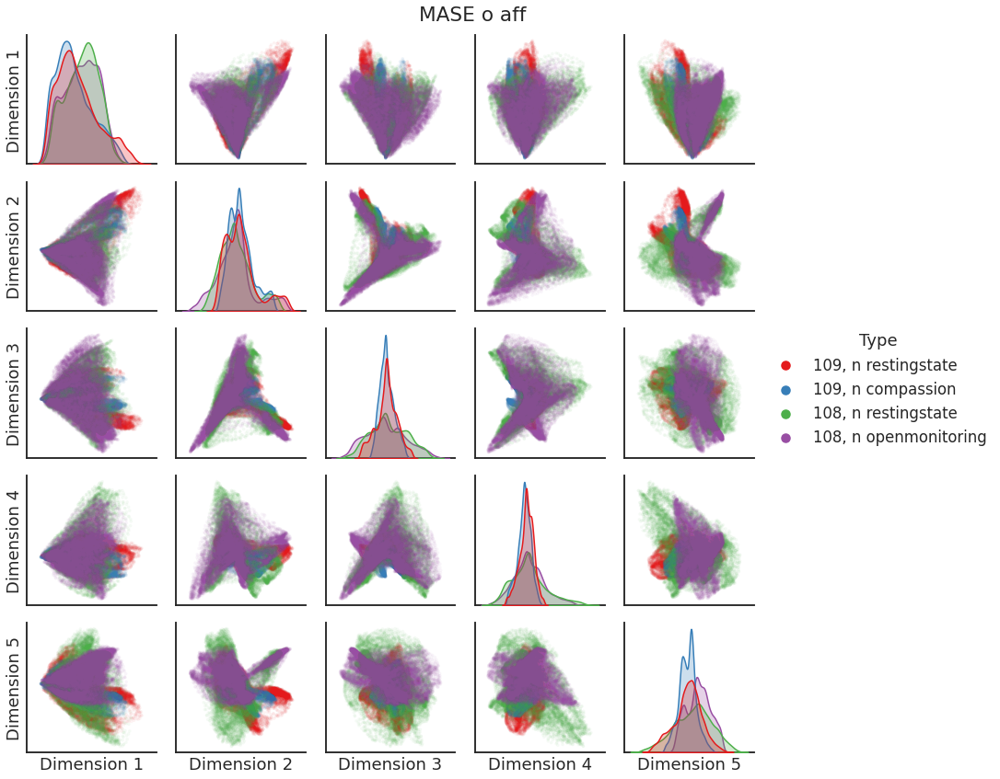

In [50]:
embeddings = Xs
pairplot(
    np.vstack(embeddings[1:5]),
    labels=np.hstack([[l]*18715 for l in labels_subj_st[1:5]]),
    alpha=0.05,
    title=f'MASE o aff'
)

## MASE scaled o Aff

In [5]:
source_dir = '/mnt/ssd3/ronan/data/mase_aff_scaled_01-07'
data = 'mase'
Xs, labels, subjs = load_data(source_dir, data, key='latent')
latent_left = load_data(source_dir, data, key='latent_left')[0][0]

print(np.linalg.norm(Xs[1], axis=0))

sort_idx = np.argsort(subjs)[::-1]
Xs = Xs[sort_idx]
labels = labels[sort_idx]
subjs = subjs[sort_idx]
labels_st = [l[0] + ' ' + l[1] for l in labels]
labels_subj_st = [f'{subj}, {l}' for subj,l in zip(subjs, labels_st)]

[1616.48146361 1015.37924343  750.16093539  602.73062762  308.33195359
  319.1046817 ]


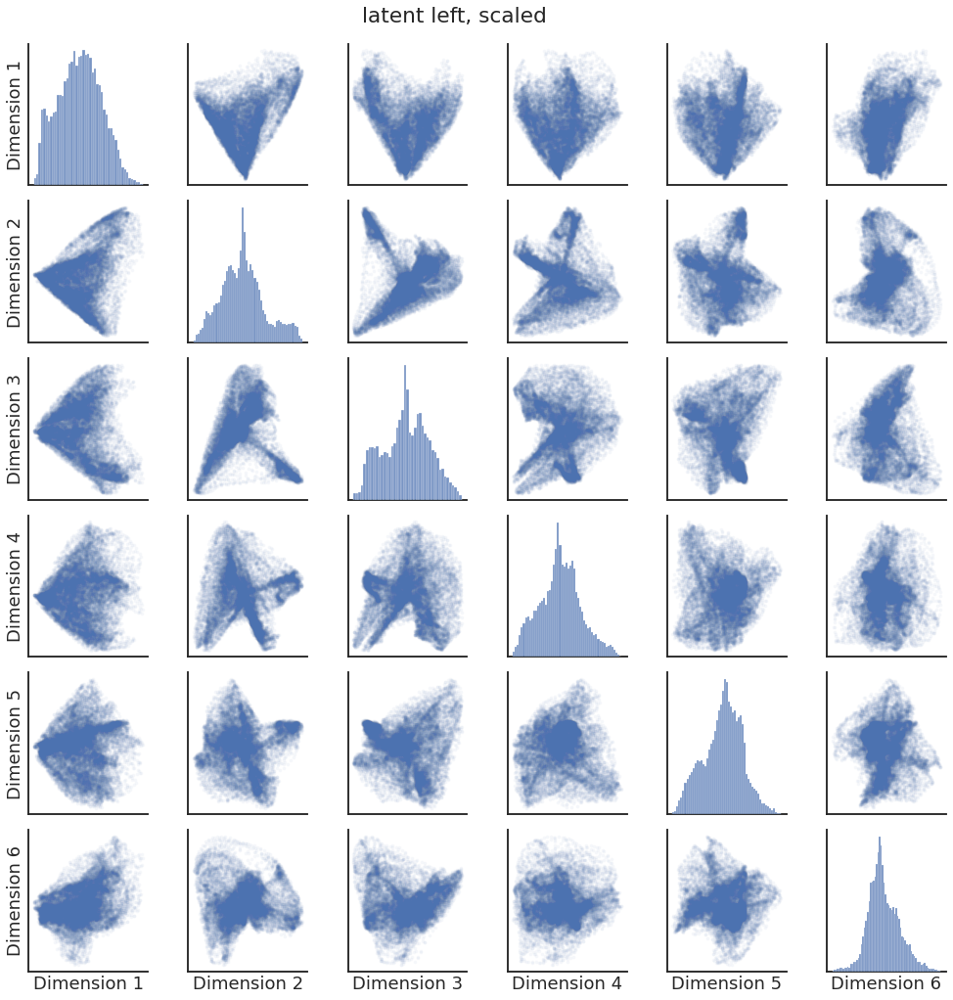

In [7]:
pairplot(
    latent_left,
    alpha=0.05,
    title=f'latent left, scaled'
)

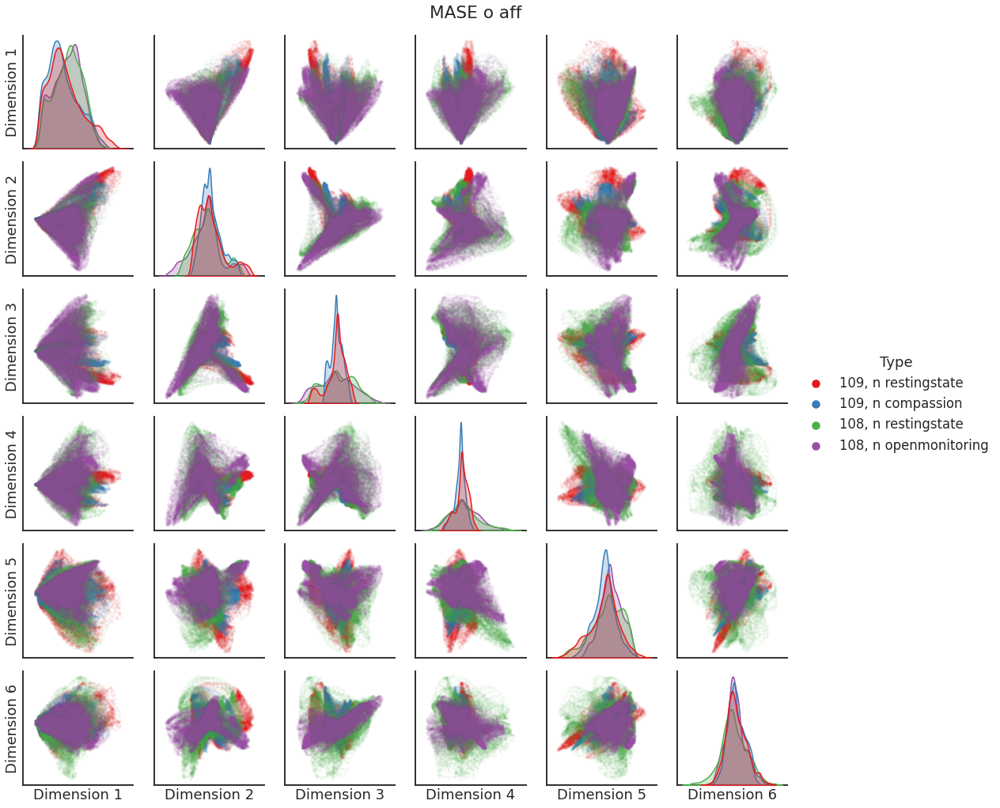

In [8]:
embeddings = Xs
pairplot(
    np.vstack(embeddings[1:5]),
    labels=np.hstack([[l]*18715 for l in labels_subj_st[1:5]]),
    alpha=0.05,
    title=f'MASE o aff'
)

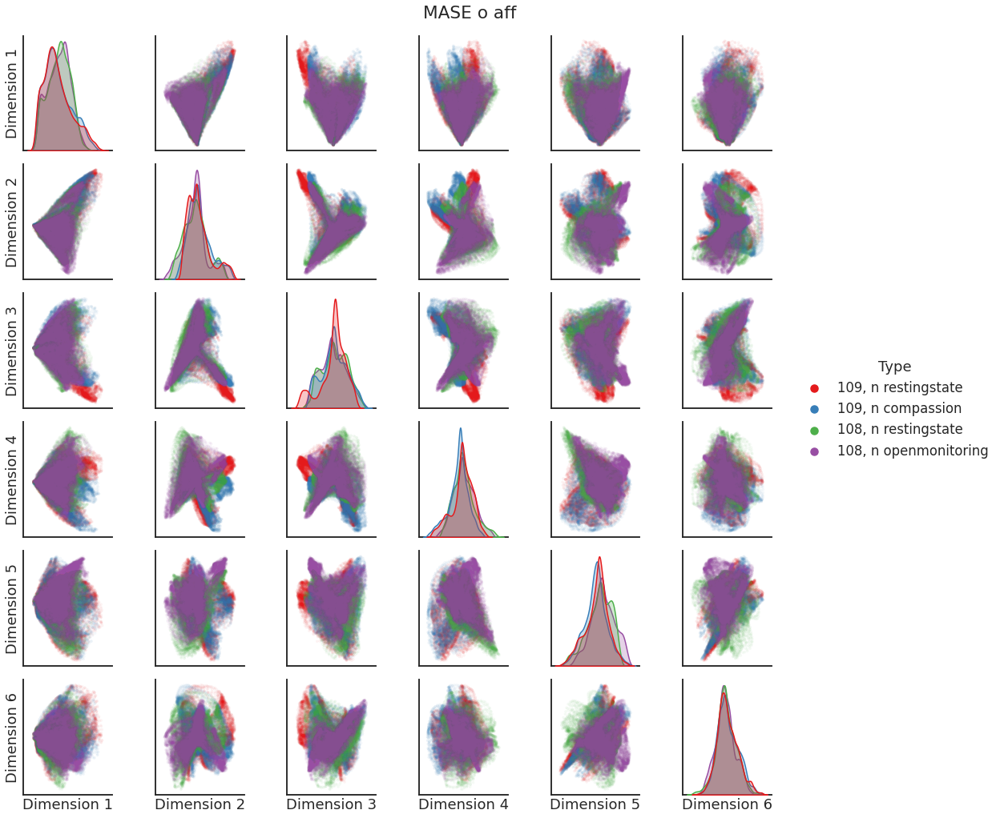

In [9]:
embeddings = Xs / np.linalg.norm(Xs, axis=1, keepdims=True)
pairplot(
    np.vstack(embeddings[1:5]),
    labels=np.hstack([[l]*18715 for l in labels_subj_st[1:5]]),
    alpha=0.05,
    title=f'MASE o aff'
)

<Figure size 432x288 with 0 Axes>

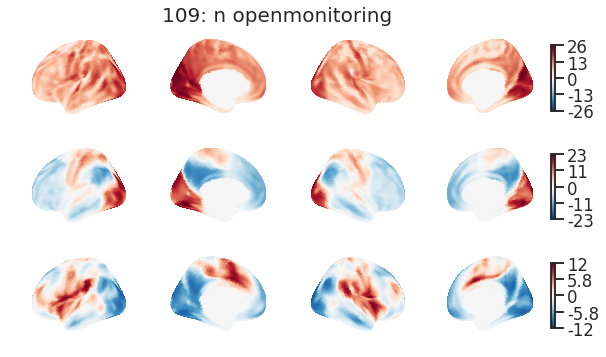

In [10]:
n_embed = 3
for X, subj, (trait, state) in zip(Xs, subjs, labels):
    title = f'{subj}: {trait} {state}'
    fig = visualize_embeddings(
        X[:, :n_embed],
        save_path=False,
        colorbar=True,
        n_embed=n_embed,
        # vmax=vmax,
        title=title,
    )
    plt.show()
    break